In this notebook, we explore several expansions of the score function. 
We'd like to find what is the correct theory that explains why linear score of Gaussian is a surprisingly good approximation of "exact" score than we expected. 

In [5]:
import torch
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms

# Define the transformation to apply to the data
transform = transforms.Compose([
    transforms.ToTensor(),
    # transforms.Normalize((0.5,), (0.5,))
])

# Download and load the MNIST dataset
train_dataset = torchvision.datasets.MNIST(root='~/Datasets', train=True, transform=transform, download=False)
test_dataset = torchvision.datasets.MNIST(root='~/Datasets', train=False, transform=transform)

# Create data loaders
# train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=64, shuffle=True)
# test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=64, shuffle=False)


In [12]:
Xtsr = torch.tensor(train_dataset.data)
Xtsr.unsqueeze_(1)
ytsr = torch.tensor(train_dataset.targets)
Xtsr = Xtsr.float() / 255.0
Xmat = Xtsr.view(Xtsr.shape[0], -1)
imgshape = tuple(Xtsr.shape[1:])
print(imgshape)

(1, 28, 28)


/tmp/ipykernel_1515734/2013224003.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  Xtsr = torch.tensor(train_dataset.data)
/tmp/ipykernel_1515734/2013224003.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  ytsr = torch.tensor(train_dataset.targets)


In [53]:
# sample noised data 
def sample_Xt_batch(Xmat, batch_size, sigma=0.01):
    idx = torch.randint(Xmat.shape[0], (batch_size,))
    Xt = Xmat[idx, :]
    Xt = Xt + sigma * torch.randn_like(Xt)
    return Xt

def sample_Xtyt_batch(Xmat, ytsr, batch_size, sigma=0.01):
    idx = torch.randint(Xmat.shape[0], (batch_size,))
    Xt = Xmat[idx, :]
    Xt = Xt + sigma * torch.randn_like(Xt)
    return Xt, ytsr[idx]

In [18]:
torch.eye

<function torch._VariableFunctionsClass.eye>

In [485]:
# define score approximators 
import torch.nn.functional as F
def mean_isotropic_score(Xt, Xmean, sigma, sigma0=0.0):
    score = (Xmean[None,] - Xt) / (sigma**2 + sigma0**2)
    return score

def Gaussian_score(Xt, Xmean, Xcov, sigma):
    cov_inv = torch.inverse(Xcov + torch.eye(Xcov.shape[0], device=Xcov.device) * sigma**2)
    score = torch.matmul((Xmean[None,] - Xt), cov_inv)
    return score

def Gaussian_1stexpens_score(Xt, Xmean, Xcov, sigma):
    cov_inv_1stexp = (torch.eye(Xcov.shape[0], device=Xcov.device) - Xcov / sigma**2) / sigma**2
    score = torch.matmul((Xmean[None,] - Xt), cov_inv_1stexp)
    return score

def Gaussian_2ndexpens_score(Xt, Xmean, Xcov, sigma):
    cov_inv_2ndexp = (torch.eye(Xcov.shape[0], device=Xcov.device) - Xcov / sigma**2 + Xcov @ Xcov / sigma**4) / sigma**2
    score = torch.matmul((Xmean[None,] - Xt), cov_inv_2ndexp)
    return score

def delta_GMM_score(Xt, Xmat, sigma):
    # get squared distance matrix
    sqdist = torch.cdist(Xt, Xmat, p=2) ** 2
    # print(sqdist.shape)
    weights = F.softmax(-sqdist / (2 * sigma**2), dim=1)
    # print(weights.shape)
    score = (torch.matmul(weights, Xmat) - Xt) / sigma**2
    # print(score.shape)
    return score

In [35]:
Xmean = Xmat.mean(dim=0)
Xcov = torch.cov(Xmat.T, )

In [93]:
eigvals, eigvecs = torch.linalg.eigh(Xcov)
eigvals = torch.flip(eigvals, dims=(0,))
eigvecs = torch.flip(eigvecs, dims=(1,))
print(eigvals.shape, eigvecs.shape)

torch.Size([784]) torch.Size([784, 784])


In [94]:
eigvals[0:10].sqrt()

tensor([2.2621, 1.9343, 1.8035, 1.6857, 1.6022, 1.5079, 1.3135, 1.2331, 1.2068,
        1.1148], device='cuda:0')

In [59]:
var_avg = torch.trace(Xcov) / Xcov.shape[0]

tensor(0.0673, device='cuda:0')

In [81]:
def explained_var(vec1, vec2):
    return 1 - (vec1 - vec2).pow(2).sum() / vec1.pow(2).sum()

def explained_var_vec(vec1, vec2):
    return 1 - (vec1 - vec2).pow(2).sum(dim=-1) / vec1.pow(2).sum(dim=-1)

device = "cuda"
Xmat = Xmat.to(device)
Xmean = Xmat.mean(dim=0)
Xcov = torch.cov(Xmat.T, ) + torch.eye(Xmat.shape[1], device=Xmat.device) * 1e-5
std_mean = (torch.trace(Xcov) / Xcov.shape[0]).sqrt()

# print(Xcov.shape)
for sigma in [0.02, 0.1, 0.2, 0.5, 0.7, 1.0, 1.5, 2.0, 5.0, 10.0]:
    Xt = sample_Xt_batch(Xmat, 2000, sigma=sigma)
    score_mean_Xt = mean_isotropic_score(Xt, Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(Xt, Xmean, sigma, sigma0=std_mean)
    score_gaussian_Xt = Gaussian_score(Xt, Xmean, Xcov, sigma)
    score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, Xmean, Xcov, sigma)
    score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, Xmean, Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(Xt, Xmat, sigma)
    print(f"sigma={sigma}")
    for name, score in [("mean isotropic", score_mean_Xt), 
                        ("mean + std isotropic", score_mean_std_Xt), 
                        ("gaussian", score_gaussian_Xt), 
                        ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ]:
        exp_var_vec = explained_var_vec(score_gmm_Xt, score)
        exp_var_rev_vec = explained_var_vec(score, score_gmm_Xt)
        print(f" {name}\tExp.Var.{exp_var_vec.mean().item()} "\
              f"\t rev Exp.Var.={exp_var_rev_vec.mean().item()} ") #; {exp_var_rev_vec.median().item()}")
    

sigma=0.02
 mean isotropic	Exp.Var.-168.12448120117188 	 rev Exp.Var.=0.006320248823612928 
 mean + std isotropic	Exp.Var.0.005877698305994272 	 rev Exp.Var.=-178.3860321044922 
 gaussian	Exp.Var.0.33727413415908813 	 rev Exp.Var.=-1.0894079208374023 
 gaussian 1st expansion	Exp.Var.-5973272064.0 	 rev Exp.Var.=-9.337068007653215e-08 
 gaussian 2nd expansion	Exp.Var.-6.41579878214271e+17 	 rev Exp.Var.=-5.960464760645934e-11 
sigma=0.1
 mean isotropic	Exp.Var.-5.765767574310303 	 rev Exp.Var.=0.13727469742298126 
 mean + std isotropic	Exp.Var.0.13009513914585114 	 rev Exp.Var.=-6.02311897277832 
 gaussian	Exp.Var.0.6580402851104736 	 rev Exp.Var.=0.48378926515579224 
 gaussian 1st expansion	Exp.Var.-374124.03125 	 rev Exp.Var.=-4.0521503251511604e-05 
 gaussian 2nd expansion	Exp.Var.-63862767616.0 	 rev Exp.Var.=4.5865775177844625e-08 
sigma=0.2
 mean isotropic	Exp.Var.-0.6815426349639893 	 rev Exp.Var.=0.38252654671669006 
 mean + std isotropic	Exp.Var.0.3728720247745514 	 rev Exp.Var

In [132]:
eigvals, eigvecs = torch.linalg.eigh(Xcov)
EPS = 1e-6
eigvals = torch.flip(eigvals, dims=(0,))
eigvecs = torch.flip(eigvecs, dims=(1,))
Xcov_half = eigvecs @ torch.diag((eigvals + EPS).sqrt()) @ eigvecs.T
assert torch.allclose(Xcov, Xcov_half @ Xcov_half, atol=1e-5)

In [ ]:
def explained_var(vec1, vec2):
    return 1 - (vec1 - vec2).pow(2).sum() / vec1.pow(2).sum()

def explained_var_vec(vec1, vec2):
    return 1 - (vec1 - vec2).pow(2).sum(dim=-1) / vec1.pow(2).sum(dim=-1)

device = "cuda"
Xmat = Xmat.to(device)
Xmean = Xmat.mean(dim=0)
Xcov = torch.cov(Xmat.T, )
std_mean = (torch.trace(Xcov) / Xcov.shape[0]).sqrt()

# print(Xcov.shape)
for sigma in [0.02, 0.1, 0.2, 0.5, 0.7, 1.0, 1.5, 2.0, 5.0, 10.0]:    
    # sample according multi variate gaussian
    X0_gauss = torch.randn([2000, Xmean.shape[0]], device=device) @ Xcov_half + Xmean
    Xt = X0_gauss + sigma * torch.randn_like(X0_gauss)
    score_mean_Xt = mean_isotropic_score(Xt, Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(Xt, Xmean, sigma, sigma0=std_mean)
    score_gaussian_Xt = Gaussian_score(Xt, Xmean, Xcov, sigma)
    score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, Xmean, Xcov, sigma)
    score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, Xmean, Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(Xt, Xmat, sigma)
    print(f"sigma={sigma}")
    for name, score in [("mean isotropic", score_mean_Xt), 
                        ("mean + std isotropic", score_mean_std_Xt), 
                        ("gaussian", score_gaussian_Xt), 
                        ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ]:
        exp_var_vec = explained_var_vec(score_gmm_Xt, score)
        exp_var_rev_vec = explained_var_vec(score, score_gmm_Xt)
        print(f" {name}\tExp.Var.{exp_var_vec.mean().item()} "\
              f"\t rev Exp.Var.={exp_var_rev_vec.mean().item()} ") #; {exp_var_rev_vec.median().item()}")
    

sigma=0.02
 mean isotropic	Exp.Var.0.0580199770629406 	 rev Exp.Var.=0.11706453561782837 
 mean + std isotropic	Exp.Var.0.006828182376921177 	 rev Exp.Var.=-26848.9765625 
 gaussian	Exp.Var.0.010601254180073738 	 rev Exp.Var.=-440.0028381347656 
 gaussian 1st expansion	Exp.Var.-38160248.0 	 rev Exp.Var.=-7.97297980170697e-05 
 gaussian 2nd expansion	Exp.Var.-4095767249682432.0 	 rev Exp.Var.=5.662441626697046e-10 
sigma=0.1
 mean isotropic	Exp.Var.0.18451909720897675 	 rev Exp.Var.=0.23801252245903015 
 mean + std isotropic	Exp.Var.0.147653728723526 	 rev Exp.Var.=-46.990264892578125 
 gaussian	Exp.Var.0.1841709017753601 	 rev Exp.Var.=-7.72489595413208 
 gaussian 1st expansion	Exp.Var.-52080.26171875 	 rev Exp.Var.=-0.0020398541819304228 
 gaussian 2nd expansion	Exp.Var.-8821756928.0 	 rev Exp.Var.=3.3111275570263388e-06 
sigma=0.2
 mean isotropic	Exp.Var.0.4316820502281189 	 rev Exp.Var.=0.4693183898925781 
 mean + std isotropic	Exp.Var.0.4149687588214874 	 rev Exp.Var.=-2.9600543975

**Observations**
* Mean isotropic; Mean + std isotropic and Gaussian are good approximations; Gaussian is getting slightly better than the isotropic scores. 
* Mean + std Isotropic and Gaussian are more stable, explaining positive variance of the GMM score even at small $\sigma$. 
* Gaussian 1st and 2nd order expansion will start diverging at small $\sigma$ values, when $\sigma^2 < \lambda$ becoming far worse approximations than even isotropic. 
* When $\sigma^2$ start to be comparable with the top eigenvalues, adding 1st order and 2nd order Gaussian terms is adding more harm!

### Distance structure between noised sample and the dataset

In [133]:

for sigma in [0.02, 0.1, 0.2, 0.5, 0.7, 1.0, 1.5, 2.0, 5.0, 10.0]:
    Xt = sample_Xt_batch(Xmat, 5000, sigma=sigma)
    distmat = torch.cdist(Xt, Xmat, p=2)
    # print(f"sigma={sigma}, dist max={distmat.max().item()}, min={distmat.min().item()}, mean={distmat.mean().item()}, median={distmat.median().item()}, dist std={distmat.std().item()}")
    print(f"sigma={sigma}", end="")
    for func, name in [
                      (torch.min, "min"),
                      (torch.max, "max"),
                      (torch.median, "median"), 
                      (torch.mean, "mean"), 
                      (torch.std, "std"),]:
        if func in [torch.median, torch.min, torch.max]:
            stats_vec = func(distmat, dim=1).values
        else:
            stats_vec = func(distmat, dim=1)
        print(f" {name}={stats_vec.mean().item():.3f}", end="")
    print()

sigma=0.02 min=0.560 max=14.966 median=10.187 mean=10.177 std=1.203
sigma=0.1 min=2.799 max=15.220 median=10.567 mean=10.563 std=1.152
sigma=0.2 min=5.599 max=15.977 median=11.633 mean=11.639 std=1.043
sigma=0.5 min=13.994 max=20.584 median=17.315 mean=17.337 std=0.722
sigma=0.7 min=19.578 max=24.783 median=22.079 mean=22.101 std=0.585
sigma=1.0 min=27.978 max=31.962 median=29.783 mean=29.803 std=0.467
sigma=1.5 min=41.869 max=44.909 median=43.188 mean=43.203 std=0.372
sigma=2.0 min=55.741 max=58.381 median=56.893 mean=56.906 std=0.327
sigma=5.0 min=139.274 max=141.470 median=140.293 mean=140.300 std=0.269
sigma=10.0 min=279.070 max=281.205 median=280.100 mean=280.103 std=0.260


In [134]:
for sigma in [0.02, 0.1, 0.2, 0.5, 0.7, 1.0, 1.5, 2.0, 5.0, 10.0]:
    Xt = sample_Xt_batch(Xmat, 5000, sigma=sigma)
    distmat = torch.cdist(Xt, Xmat, p=2)**2 / sigma**2
    # print(f"sigma={sigma}, dist max={distmat.max().item()}, min={distmat.min().item()}, mean={distmat.mean().item()}, median={distmat.median().item()}, dist std={distmat.std().item()}")
    print(f"sigma={sigma}", end="")
    for func, name in [
                      (torch.min, "min"),
                      (torch.max, "max"),
                      (torch.median, "median"), 
                      (torch.mean, "mean"), 
                      (torch.std, "std"),]:
        if func in [torch.median, torch.min, torch.max]:
            stats_vec = func(distmat, dim=1).values
        else:
            stats_vec = func(distmat, dim=1)
        print(f" {name}={stats_vec.mean().item():.3f}", end="")
    print()

sigma=0.02 min=784.551 max=560838.312 median=261012.422 mean=264108.469 std=59908.164
sigma=0.1 min=783.721 max=23184.207 median=11197.188 mean=11323.918 std=2393.802
sigma=0.2 min=785.163 max=6393.518 median=3389.556 mean=3420.610 std=601.504
sigma=0.5 min=784.056 max=1694.463 median=1201.162 mean=1206.284 std=99.747
sigma=0.7 min=783.360 max=1253.478 median=996.236 mean=998.823 std=52.649
sigma=1.0 min=782.559 max=1021.553 median=887.965 mean=889.335 std=27.797
sigma=1.5 min=780.760 max=898.255 median=830.777 mean=831.457 std=14.313
sigma=2.0 min=777.607 max=852.956 median=809.997 mean=810.398 std=9.325
sigma=5.0 min=776.258 max=800.988 median=787.694 mean=787.769 std=3.038
sigma=10.0 min=779.273 max=791.248 median=785.029 mean=785.048 std=1.462


In [ ]:
import numpy as np

def find_min_elements(matrix):
    num_elements = []
    for row in matrix:
        sorted_row = np.sort(row)
        cumulative_sum = np.cumsum(sorted_row)
        min_elements = np.argmax(cumulative_sum > 0.99) + 1
        num_elements.append(min_elements)
    return num_elements

# Example usage
weights = np.array([[0.2, 0.3, 0.5], [0.1, 0.4, 0.5]])
min_elements = find_min_elements(weights)
print(min_elements)
# given a matrix of weights where each row sum up to one find 
# the minimal number of element that is required to make the sum > 0.99

In [114]:
cumulative_sum > 0.99

tensor([[False, False, False,  ..., False, False,  True],
        [False, False, False,  ..., False, False,  True],
        [False, False, False,  ..., False, False,  True],
        ...,
        [False, False, False,  ..., False, False,  True],
        [False, False, False,  ..., False, False,  True],
        [False, False, False,  ..., False, False,  True]], device='cuda:0')

In [119]:
min_elements

tensor([1, 1, 1,  ..., 1, 1, 1], device='cuda:0')

In [142]:
print("Sample probing points from original dataset + noise")
for sigma in [0.02, 0.1, 0.2, 0.5, 0.7, 1.0, 1.5, 2.0, 2.5, 3.0, 4.0, 5.0, 10.0]:
    Xt = sample_Xt_batch(Xmat, 5000, sigma=sigma)
    distmat = torch.cdist(Xt, Xmat, p=2)
    weights = F.softmax(-distmat**2 / (2 * sigma**2), dim=1)
    weights_sorted = torch.sort(weights, dim=1, descending=True).values
    cumulative_sum = torch.cumsum(weights_sorted, dim=1)
    min_elem999 = torch.argmax((cumulative_sum > 0.999).float(), dim=1) + 1
    min_elem99 = torch.argmax((cumulative_sum > 0.99).float(), dim=1) + 1
    min_elem90 = torch.argmax((cumulative_sum > 0.90).float(), dim=1) + 1
    min_elem80 = torch.argmax((cumulative_sum > 0.80).float(), dim=1) + 1
    min_elem50 = torch.argmax((cumulative_sum > 0.50).float(), dim=1) + 1
    print(f"sigma={sigma} # of sample for pcent weight", end="")
    for numvec, name in [
                      (min_elem50, "50%"),
                      (min_elem80, "80%"),
                      (min_elem90, "90%"),
                        (min_elem99, "99%"),
                        (min_elem999, "99.9%"),
                        ]:
        # if func in [torch.median, torch.min, torch.max]:
        stats = torch.median(numvec, dim=0).values
        print(f" {name}={stats.item():.0f}", end="")
    print()

Sample probing points from original dataset + noise
sigma=0.02 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=1 99.9%=1
sigma=0.1 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=1 99.9%=1
sigma=0.2 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=1 99.9%=1
sigma=0.5 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=1 99.9%=1
sigma=0.7 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=1 99.9%=1
sigma=1.0 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=3 99.9%=11
sigma=1.5 # of sample for pcent weight 50%=4 80%=27 90%=72 99%=593 99.9%=2208
sigma=2.0 # of sample for pcent weight 50%=49 80%=394 90%=1006 99%=5987 99.9%=15452
sigma=2.5 # of sample for pcent weight 50%=262 80%=1741 90%=3894 99%=16352 99.9%=31546
sigma=3.0 # of sample for pcent weight 50%=797 80%=4281 90%=8507 99%=26963 99.9%=42734
sigma=4.0 # of sample for pcent weight 50%=2636 80%=10705 90%=18383 99%=41050 99.9%=53097
sigma=5.0 # of sample for pcent weight 50%=4970 80%=16894 90%=26323 99%=48086 99.9%=56621
sigm

In [141]:
print("Sample probing points from Gaussian approx of data + noise")
for sigma in [0.02, 0.1, 0.2, 0.5, 0.7, 1.0, 1.5, 2.0, 2.5, 3.0, 4.0, 5.0, 10.0]:
    X0_gauss = torch.randn([2000, Xmean.shape[0]], device=device) @ Xcov_half + Xmean
    Xt = X0_gauss + sigma * torch.randn_like(X0_gauss)
    distmat = torch.cdist(Xt, Xmat, p=2)
    weights = F.softmax(-distmat**2 / (2 * sigma**2), dim=1)
    weights_sorted = torch.sort(weights, dim=1, descending=True).values
    cumulative_sum = torch.cumsum(weights_sorted, dim=1)
    min_elem999 = torch.argmax((cumulative_sum > 0.999).float(), dim=1) + 1
    min_elem99 = torch.argmax((cumulative_sum > 0.99).float(), dim=1) + 1
    min_elem90 = torch.argmax((cumulative_sum > 0.90).float(), dim=1) + 1
    min_elem80 = torch.argmax((cumulative_sum > 0.80).float(), dim=1) + 1
    min_elem50 = torch.argmax((cumulative_sum > 0.50).float(), dim=1) + 1
    print(f"sigma={sigma} # of sample for pcent weight", end="")
    for numvec, name in [
                      (min_elem50, "50%"),
                      (min_elem80, "80%"),
                      (min_elem90, "90%"),
                      (min_elem99, "99%"),
                      (min_elem999, "99.9%"),
                        ]:
        # if func in [torch.median, torch.min, torch.max]:
        stats = torch.median(numvec, dim=0).values
        print(f" {name}={stats.item():.0f}", end="")
    print()

sigma=0.02 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=1 99.9%=1
sigma=0.1 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=1 99.9%=1
sigma=0.2 # of sample for pcent weight 50%=1 80%=1 90%=1 99%=1 99.9%=1
sigma=0.5 # of sample for pcent weight 50%=1 80%=1 90%=2 99%=3 99.9%=6
sigma=0.7 # of sample for pcent weight 50%=1 80%=2 90%=3 99%=10 99.9%=29
sigma=1.0 # of sample for pcent weight 50%=2 80%=6 90%=13 99%=92 99.9%=365
sigma=1.5 # of sample for pcent weight 50%=10 80%=76 90%=207 99%=1599 99.9%=5124
sigma=2.0 # of sample for pcent weight 50%=73 80%=590 90%=1453 99%=7923 99.9%=18585
sigma=2.5 # of sample for pcent weight 50%=343 80%=2144 90%=4616 99%=17819 99.9%=33004
sigma=3.0 # of sample for pcent weight 50%=882 80%=4658 90%=9107 99%=27806 99.9%=43383
sigma=4.0 # of sample for pcent weight 50%=2707 80%=11016 90%=18802 99%=41170 99.9%=53140
sigma=5.0 # of sample for pcent weight 50%=5047 80%=16982 90%=26348 99%=48182 99.9%=56643
sigma=10.0 # of sample for pcent weight 50%=1439

Observation:
* For MNIST dataset, at sigma level $\sigma<=0.7$ effectively the delta GMM score is generated by a single data point! 
 Kind of make sense that at this moment the Gaussian approximation fails miserabley. 
* If we sample probing points from a Gaussian, the score is slightly more distributed, at lower $\sigma$ level it still has multiple source of influence. 

In [63]:
rad_vec = (Xmat - Xmean).pow(2).sum(dim=1).sqrt()
print(rad_vec.max())
print(rad_vec.min())
print(rad_vec.mean())
print(rad_vec.std())

tensor(12.2324, device='cuda:0')
tensor(5.2739, device='cuda:0')
tensor(7.1944, device='cuda:0')
tensor(0.9824, device='cuda:0')


In [64]:
distmat = torch.cdist(Xmat, Xmat, p=2)

In [70]:
print(distmat.max())
print(distmat.mean())

tensor(16.8758, device='cuda:0')
tensor(10.1686, device='cuda:0')


### Load and Examine the EDM trained model w.r.t. scores

In [176]:
import numpy as np
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
from torchvision.utils import save_image

In [144]:
import argparse

parser = argparse.ArgumentParser()
parser.add_argument("--expr", type=str, default="sampling", help="experiment name")
parser.add_argument("--dataset", type=str, default="mnist")
parser.add_argument('--seed', default=42, type=int, help='global seed')
parser.add_argument("--img_size", type=int, default=32)
parser.add_argument("--model_paths", default='', type=str, help='model paths')
# EDM models parameters
parser.add_argument('--sigma_min', default=0.002, type=float, help='sigma_min')
parser.add_argument('--sigma_max', default=80.0, type=float, help='sigma_max')
parser.add_argument('--rho', default=7., type=float, help='Schedule hyper-parameter')
parser.add_argument('--sigma_data', default=0.5, type=float, help='sigma_data used in EDM for c_skip and c_out')
# Sampling parameters
parser.add_argument('--total_steps', default=18, type=int, help='total_steps')
parser.add_argument("--eval_batch_size", type=int, default=64)
parser.add_argument("--fid_batch_size", type=int, default=64)
parser.add_argument("--sample_mode", type=str, default='fid', help='sample mode')
parser.add_argument('--num_fid_sample', default=10000, type=int, help='num_fid_sample')
parser.add_argument('--t_path', default='./CIFAR-10-images/train', type=str, help='source clean image path')
parser.add_argument('--begin_ckpt', default=0, type=int, help='begin_ckpt')
# Model architecture
parser.add_argument('--model_channels', default=64, type=int, help='model_channels')
parser.add_argument('--channel_mult', default=[1,2,2,2], type=int, nargs='+', help='channel_mult')
parser.add_argument('--attn_resolutions', default=[], type=int, nargs='+', help='attn_resolutions')
parser.add_argument('--layers_per_block', default=4, type=int, help='num_blocks')

config = parser.parse_args([])
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
config.device = device
channels = {'mnist': 1, 'cifar10': 3}
config.channels = channels[config.dataset]

In [150]:
# config for MNIST
config.channel_mult = [1, 2, 3, 4]
config.model_channels = 16
config.attn_resolutions = [0,]
config.layers_per_block = 1
config.num_fid_sample = 5000
config.fid_batch_size = 1024

In [151]:
config

Namespace(expr='sampling', dataset='mnist', seed=42, img_size=32, model_paths='', sigma_min=0.002, sigma_max=80.0, rho=7.0, sigma_data=0.5, total_steps=18, eval_batch_size=64, fid_batch_size=1024, sample_mode='fid', num_fid_sample=5000, t_path='./CIFAR-10-images/train', begin_ckpt=0, model_channels=16, channel_mult=[1, 2, 3, 4], attn_resolutions=[0], layers_per_block=1, device=device(type='cuda'), channels=1)

In [209]:
import sys
sys.path.append("/n/home12/binxuwang/Github/mini_edm")
from train_edm import edm_sampler
from train_edm import EDM
from train_edm import create_model

def load_create_edm(config, model_path):
    # model_path = f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_75000.pth"
    unet = create_model(config)
    edm = EDM(model=unet, cfg=config)
    checkpoint = torch.load(model_path, map_location=device)
    # logger.info(f"loaded model: {model_name}")
    edm.model.load_state_dict(checkpoint)
    for param in edm.model.parameters():
        param.requires_grad = False
    edm.model.eval()
    return edm

model_path = f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_75000.pth"
unet = create_model(config)
edm = EDM(model=unet, cfg=config)
checkpoint = torch.load(model_path, map_location=device)
# logger.info(f"loaded model: {model_name}")
edm.model.load_state_dict(checkpoint)
for param in edm.model.parameters():
    param.requires_grad = False
edm.model.eval()

SongUNet(
  (map_noise): PositionalEmbedding()
  (map_augment): Linear()
  (map_layer0): Linear()
  (map_layer1): Linear()
  (enc): ModuleDict(
    (32x32_conv): Conv2d()
    (32x32_block0): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
      (norm1): GroupNorm()
      (conv1): Conv2d()
    )
    (16x16_down): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
      (norm1): GroupNorm()
      (conv1): Conv2d()
      (skip): Conv2d()
    )
    (16x16_block0): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
      (norm1): GroupNorm()
      (conv1): Conv2d()
      (skip): Conv2d()
    )
    (8x8_down): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
      (norm1): GroupNorm()
      (conv1): Conv2d()
      (skip): Conv2d()
    )
    (8x8_block0): UNetBlock(
      (norm0): GroupNorm()
      (conv0): Conv2d()
      (affine): Linear()
     

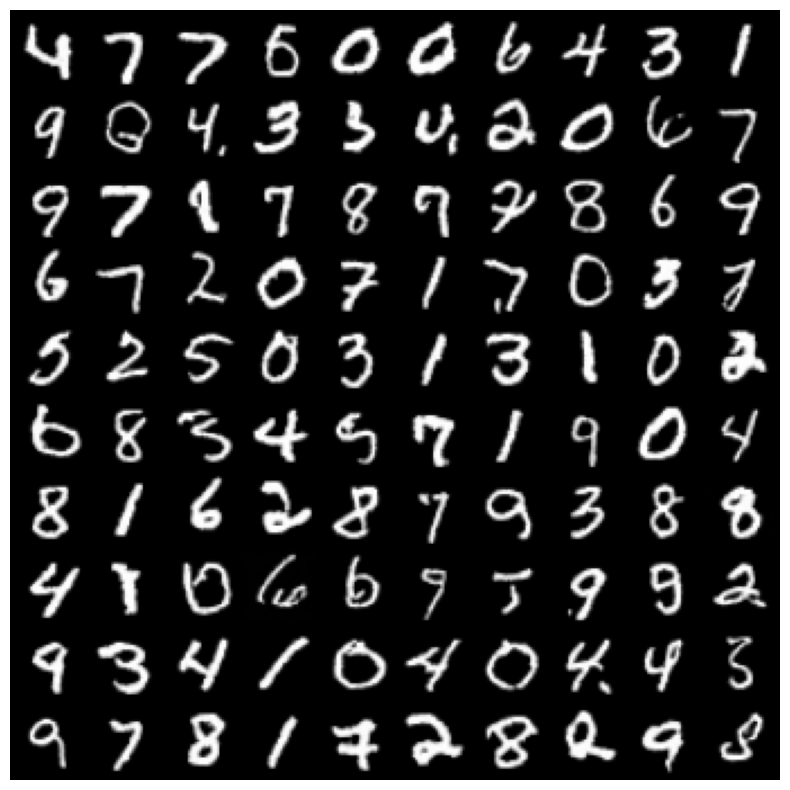

In [224]:
fid_batch_size = 100
with torch.no_grad():
    noise = torch.randn([fid_batch_size, config.channels, config.img_size, config.img_size],
                        generator=torch.cuda.manual_seed(config.seed), device=config.device)
    samples = edm_sampler(edm, noise, num_steps=config.total_steps, use_ema=False).detach().cpu()
    samples.mul_(0.5).add_(0.5)
samples = torch.clamp(samples, 0., 1.).cpu()
# samples = np.clip(samples.permute(0, 2, 3, 1).cpu().numpy() * 255., 0, 255).astype(np.uint8)
# samples = samples.reshape((-1, config.img_size, config.img_size, config.channels))
# all_samples.append(samples)

plt.figure(figsize=(10, 10))
plt.imshow((make_grid(samples*255.0, nrow=10).permute(1, 2, 0)).numpy().astype(np.uint8))
plt.axis('off')
plt.show()

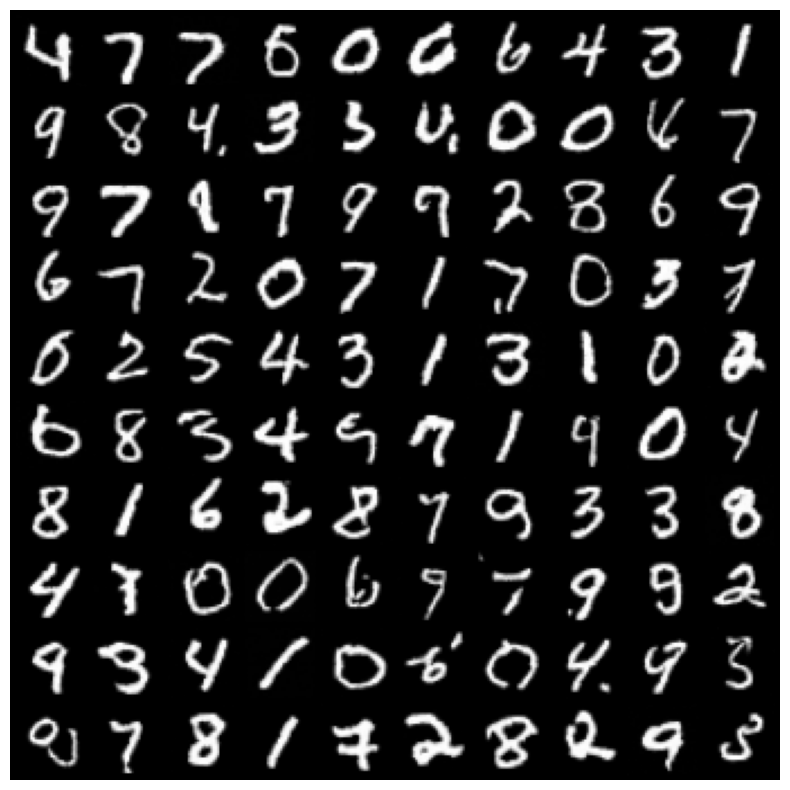

In [174]:
plt.figure(figsize=(10, 10))
plt.imshow((make_grid(samples*255.0, nrow=10).permute(1, 2, 0)).numpy().astype(np.uint8))
plt.axis('off')
plt.show()

### score checking

In [178]:
transform = transforms.Compose([
    torchvision.transforms.Resize(config.img_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Download and load the MNIST dataset
train_edm_dataset = torchvision.datasets.MNIST(root='~/Datasets', train=True, transform=transform, download=False)
test_edm_dataset = torchvision.datasets.MNIST(root='~/Datasets', train=False, transform=transform)

In [185]:
edm_Xtsr = torch.stack([train_edm_dataset[i][0] for i in range(len(train_edm_dataset))])

In [397]:
edm_Xtsr_test = torch.stack([test_edm_dataset[i][0] for i in range(len(test_edm_dataset))])
edm_Xmat_test = edm_Xtsr_test.view(edm_Xtsr_test.shape[0], -1)
ytsr_test = torch.tensor(test_edm_dataset.targets)

/tmp/ipykernel_1515734/285922032.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  ytsr_test = torch.tensor(test_edm_dataset.targets)


In [186]:
edm_Xmat = edm_Xtsr.view(edm_Xtsr.shape[0], -1).cuda()
edm_Xmean = edm_Xmat.mean(dim=0)
edm_Xcov = torch.cov(edm_Xmat.T, )
edm_imgshape = tuple(edm_Xtsr.shape[1:])

In [ ]:
eigvals, eigvecs = torch.linalg.eigh(edm_Xcov)
eigvals = torch.flip(eigvals, dims=(0,))
eigvecs = torch.flip(eigvecs, dims=(1,))
print(eigvals.shape, eigvecs.shape)
print(eigvals[0:10].sqrt())

torch.Size([1024]) torch.Size([1024, 1024])
tensor([5.0782, 4.2297, 3.9882, 3.7294, 3.5631, 3.3024, 2.9141, 2.6671, 2.6480,
        2.4165], device='cuda:0')


In [210]:
def explained_var(vec1, vec2):
    return 1 - (vec1 - vec2).pow(2).sum() / vec1.pow(2).sum()

def explained_var_vec(vec1, vec2):
    return 1 - (vec1 - vec2).pow(2).sum(dim=-1) / vec1.pow(2).sum(dim=-1)


In [214]:
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_25000.pth")
device = "cuda"
edm_Xmat = edm_Xtsr.view(edm_Xtsr.shape[0], -1).to(device)
edm_Xmean = edm_Xmat.mean(dim=0)
edm_Xcov = torch.cov(edm_Xmat.T, )
edm_imgshape = tuple(edm_Xtsr.shape[1:])
edm_std_mean = (torch.trace(Xcov) / Xcov.shape[0]).sqrt()

# print(Xcov.shape)
for sigma in [0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 0.75, 1.0, 1.5, 2.0, 5.0, 10.0]:
    Xt = sample_Xt_batch(edm_Xmat, 2000, sigma=sigma)
    edm_Dt = edm(Xt.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(Xt.shape) - Xt) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(Xt, edm_Xmat, sigma)
    print(f"sigma={sigma}")
    for name, score in [("mean isotropic", score_mean_Xt), 
                        ("mean + std isotropic", score_mean_std_Xt), 
                        ("gaussian", score_gaussian_Xt), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ("gmm delta", score_gmm_Xt),
                        ]:
        exp_var_vec = explained_var_vec(score_edm, score)
        exp_var_rev_vec = explained_var_vec(score, score_edm)
        print(f" {name}\tExp.Var.{exp_var_vec.mean().item()} "\
              f"\t rev Exp.Var.={exp_var_rev_vec.mean().item()} ") #; {exp_var_rev_vec.median().item()}")
    

sigma=0.01
 mean isotropic	Exp.Var.-3168.078125 	 rev Exp.Var.=0.0008527630125172436 
 mean + std isotropic	Exp.Var.-0.0016621120739728212 	 rev Exp.Var.=-166.18272399902344 
 gaussian	Exp.Var.0.2752004861831665 	 rev Exp.Var.=0.05552366003394127 
 gmm delta	Exp.Var.0.6718178391456604 	 rev Exp.Var.=0.7682291269302368 
sigma=0.02
 mean isotropic	Exp.Var.-667.5308837890625 	 rev Exp.Var.=0.002406325424090028 
 mean + std isotropic	Exp.Var.-0.00858358945697546 	 rev Exp.Var.=-47.295372009277344 
 gaussian	Exp.Var.0.5288662314414978 	 rev Exp.Var.=0.16065281629562378 
 gmm delta	Exp.Var.0.8069067001342773 	 rev Exp.Var.=0.8374648690223694 
sigma=0.05
 mean isotropic	Exp.Var.-100.06140899658203 	 rev Exp.Var.=0.014200900681316853 
 mean + std isotropic	Exp.Var.-0.047535065561532974 	 rev Exp.Var.=-7.64072322845459 
 gaussian	Exp.Var.0.6532530784606934 	 rev Exp.Var.=0.4737881124019623 
 gmm delta	Exp.Var.0.8831161260604858 	 rev Exp.Var.=0.894913375377655 
sigma=0.1
 mean isotropic	Exp.Var

In [217]:
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_50000.pth")
device = "cuda"
edm_Xmat = edm_Xtsr.view(edm_Xtsr.shape[0], -1).to(device)
edm_Xmean = edm_Xmat.mean(dim=0)
edm_Xcov = torch.cov(edm_Xmat.T, )
edm_imgshape = tuple(edm_Xtsr.shape[1:])
edm_std_mean = (torch.trace(Xcov) / Xcov.shape[0]).sqrt()

# print(Xcov.shape)
for sigma in [0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 0.75, 1.0, 1.5, 2.0, 5.0, 10.0]:
    Xt = sample_Xt_batch(edm_Xmat, 2000, sigma=sigma)
    edm_Dt = edm(Xt.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(Xt.shape) - Xt) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(Xt, edm_Xmat, sigma)
    print(f"sigma={sigma}")
    for name, score in [("mean isotropic", score_mean_Xt), 
                        ("mean + std isotropic", score_mean_std_Xt), 
                        ("gaussian", score_gaussian_Xt), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ("gmm delta", score_gmm_Xt),
                        ]:
        exp_var_vec = explained_var_vec(score_edm, score)
        exp_var_rev_vec = explained_var_vec(score, score_edm)
        print(f" {name}\tExp.Var. {exp_var_vec.mean().item()} "\
              f"\t rev Exp.Var. {exp_var_rev_vec.mean().item()} ") #; {exp_var_rev_vec.median().item()}")
    

sigma=0.01
 mean isotropic	Exp.Var. -2924.257568359375 	 rev Exp.Var. 0.0007565445848740637 
 mean + std isotropic	Exp.Var. -0.0018216574098914862 	 rev Exp.Var. -176.51702880859375 
 gaussian	Exp.Var. 0.28616055846214294 	 rev Exp.Var. 0.026943061500787735 
 gmm delta	Exp.Var. 0.7301867604255676 	 rev Exp.Var. 0.793822169303894 
sigma=0.02
 mean isotropic	Exp.Var. -662.6802368164062 	 rev Exp.Var. 0.002609150717034936 
 mean + std isotropic	Exp.Var. -0.0076701645739376545 	 rev Exp.Var. -46.93265151977539 
 gaussian	Exp.Var. 0.5319910049438477 	 rev Exp.Var. 0.17336368560791016 
 gmm delta	Exp.Var. 0.82415372133255 	 rev Exp.Var. 0.8507366180419922 
sigma=0.05
 mean isotropic	Exp.Var. -98.98814392089844 	 rev Exp.Var. 0.01419360376894474 
 mean + std isotropic	Exp.Var. -0.04672004282474518 	 rev Exp.Var. -7.752403259277344 
 gaussian	Exp.Var. 0.6529766917228699 	 rev Exp.Var. 0.46548035740852356 
 gmm delta	Exp.Var. 0.8909317851066589 	 rev Exp.Var. 0.9015178680419922 
sigma=0.1
 mean

In [226]:
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_75000.pth")
    
device = "cuda"
edm_Xmat = edm_Xtsr.view(edm_Xtsr.shape[0], -1).to(device)
edm_Xmean = edm_Xmat.mean(dim=0)
edm_Xcov = torch.cov(edm_Xmat.T, )
edm_imgshape = tuple(edm_Xtsr.shape[1:])
edm_std_mean = (torch.trace(Xcov) / Xcov.shape[0]).sqrt()

# print(Xcov.shape)
for sigma in [0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 0.75, 1.0, 1.5, 2.0, 5.0, 10.0, ]:
    Xt = sample_Xt_batch(edm_Xmat, 2000, sigma=sigma)
    edm_Dt = edm(Xt.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(Xt.shape) - Xt) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(Xt, edm_Xmat, sigma)
    print(f"sigma={sigma}")
    for name, score in [("mean isotropic", score_mean_Xt), 
                        ("mean + std isotropic", score_mean_std_Xt), 
                        ("gaussian", score_gaussian_Xt), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ("gmm delta", score_gmm_Xt),
                        ]:
        exp_var_vec = explained_var_vec(score_edm, score)
        exp_var_rev_vec = explained_var_vec(score, score_edm)
        print(f" {name}\tExp.Var. {exp_var_vec.mean().item()} "\
              f"\t rev Exp.Var. {exp_var_rev_vec.mean().item()} ") #; {exp_var_rev_vec.median().item()}")
    

sigma=0.01
 mean isotropic	Exp.Var. -2917.1806640625 	 rev Exp.Var. 0.000609740789514035 
 mean + std isotropic	Exp.Var. -0.002521313726902008 	 rev Exp.Var. -177.3274383544922 
 gaussian	Exp.Var. 0.30414825677871704 	 rev Exp.Var. 0.025901729241013527 
 gmm delta	Exp.Var. 0.7476081848144531 	 rev Exp.Var. 0.8042603135108948 
sigma=0.02
 mean isotropic	Exp.Var. -663.2575073242188 	 rev Exp.Var. 0.00254442123696208 
 mean + std isotropic	Exp.Var. -0.008038296364247799 	 rev Exp.Var. -46.97417449951172 
 gaussian	Exp.Var. 0.5371341109275818 	 rev Exp.Var. 0.17284540832042694 
 gmm delta	Exp.Var. 0.8321826457977295 	 rev Exp.Var. 0.8578644394874573 
sigma=0.05
 mean isotropic	Exp.Var. -98.03926086425781 	 rev Exp.Var. 0.014159111306071281 
 mean + std isotropic	Exp.Var. -0.0463344044983387 	 rev Exp.Var. -7.816861629486084 
 gaussian	Exp.Var. 0.6508159637451172 	 rev Exp.Var. 0.46431541442871094 
 gmm delta	Exp.Var. 0.8948584198951721 	 rev Exp.Var. 0.9052230715751648 
sigma=0.1
 mean iso

* Gaussian explains 30% var of edm, but edm only explains 0.03 var of Gaussian, showing that Gaussian has more total variance than edm?
* GMM delta explains 74% of var of EDM score, but EDM score explains 80% of GMM delta, showing that EDM score has higher variance than GMM?

In [229]:
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_100000.pth")
device = "cuda"
edm_Xmat = edm_Xtsr.view(edm_Xtsr.shape[0], -1).to(device)
edm_Xmean = edm_Xmat.mean(dim=0)
edm_Xcov = torch.cov(edm_Xmat.T, )
edm_imgshape = tuple(edm_Xtsr.shape[1:])
edm_std_mean = (torch.trace(Xcov) / Xcov.shape[0]).sqrt()

# print(Xcov.shape)
for sigma in [0.002, 0.005, 0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 0.75, 1.0, 1.5, 2.0, 5.0, 10.0]:
    Xt = sample_Xt_batch(edm_Xmat, 5000, sigma=sigma)
    edm_Dt = edm(Xt.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(Xt.shape) - Xt) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(Xt, edm_Xmat, sigma)
    print(f"sigma={sigma}")
    for name, score in [("mean isotropic", score_mean_Xt), 
                        ("mean + std isotropic", score_mean_std_Xt), 
                        ("gaussian", score_gaussian_Xt), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ("gmm delta", score_gmm_Xt),
                        ]:
        exp_var_vec = explained_var_vec(score_edm, score)
        exp_var_rev_vec = explained_var_vec(score, score_edm)
        print(f" {name}\tExp.Var. {exp_var_vec.mean().item()} "\
              f"\t rev Exp.Var. {exp_var_rev_vec.mean().item()} ") #; {exp_var_rev_vec.median().item()}")
    

sigma=0.002
 mean isotropic	Exp.Var. -270935.34375 	 rev Exp.Var. -0.00014012503379490227 
 mean + std isotropic	Exp.Var. -0.00288417492993176 	 rev Exp.Var. -1275.8887939453125 
 gaussian	Exp.Var. -199.47557067871094 	 rev Exp.Var. -0.004285365808755159 
 gmm delta	Exp.Var. -1.4877269268035889 	 rev Exp.Var. 0.46937304735183716 
sigma=0.005
 mean isotropic	Exp.Var. -15975.1865234375 	 rev Exp.Var. 1.7665957784629427e-05 
 mean + std isotropic	Exp.Var. -0.0018205890664830804 	 rev Exp.Var. -549.6715087890625 
 gaussian	Exp.Var. -17.720664978027344 	 rev Exp.Var. -0.028436288237571716 
 gmm delta	Exp.Var. 0.5209484696388245 	 rev Exp.Var. 0.7294464111328125 
sigma=0.01
 mean isotropic	Exp.Var. -2898.823486328125 	 rev Exp.Var. 0.0006703943945467472 
 mean + std isotropic	Exp.Var. -0.0022639480885118246 	 rev Exp.Var. -176.62918090820312 
 gaussian	Exp.Var. 0.31109553575515747 	 rev Exp.Var. 0.033941105008125305 
 gmm delta	Exp.Var. 0.7558889389038086 	 rev Exp.Var. 0.8103107213973999 
s

In [230]:
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_125000.pth")
device = "cuda"
edm_Xmat = edm_Xtsr.view(edm_Xtsr.shape[0], -1).to(device)
edm_Xmean = edm_Xmat.mean(dim=0)
edm_Xcov = torch.cov(edm_Xmat.T, )
edm_imgshape = tuple(edm_Xtsr.shape[1:])
edm_std_mean = (torch.trace(Xcov) / Xcov.shape[0]).sqrt()

# print(Xcov.shape)
for sigma in [0.002, 0.005, 0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 0.75, 1.0, 1.5, 2.0, 5.0, 10.0]:
    Xt = sample_Xt_batch(edm_Xmat, 5000, sigma=sigma)
    edm_Dt = edm(Xt.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(Xt.shape) - Xt) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(Xt, edm_Xmat, sigma)
    print(f"sigma={sigma}")
    for name, score in [("mean isotropic", score_mean_Xt), 
                        ("mean + std isotropic", score_mean_std_Xt), 
                        ("gaussian", score_gaussian_Xt), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ("gmm delta", score_gmm_Xt),
                        ]:
        exp_var_vec = explained_var_vec(score_edm, score)
        exp_var_rev_vec = explained_var_vec(score, score_edm)
        print(f" {name}\tExp.Var. {exp_var_vec.mean().item()} "\
              f"\t rev Exp.Var. {exp_var_rev_vec.mean().item()} ") #; {exp_var_rev_vec.median().item()}")
    

sigma=0.002
 mean isotropic	Exp.Var. -250848.25 	 rev Exp.Var. -0.00017609259521123022 
 mean + std isotropic	Exp.Var. -0.0030935064423829317 	 rev Exp.Var. -1360.3707275390625 
 gaussian	Exp.Var. -188.32606506347656 	 rev Exp.Var. -0.0050946385599672794 
 gmm delta	Exp.Var. -1.2682924270629883 	 rev Exp.Var. 0.4851462244987488 
sigma=0.005
 mean isotropic	Exp.Var. -15587.1005859375 	 rev Exp.Var. 1.6138981663971208e-05 
 mean + std isotropic	Exp.Var. -0.0017717143055051565 	 rev Exp.Var. -557.4221801757812 
 gaussian	Exp.Var. -16.48112678527832 	 rev Exp.Var. -0.030194884166121483 
 gmm delta	Exp.Var. 0.5433433651924133 	 rev Exp.Var. 0.7349072098731995 
sigma=0.01
 mean isotropic	Exp.Var. -2902.986328125 	 rev Exp.Var. 0.0007180653628893197 
 mean + std isotropic	Exp.Var. -0.002041255822405219 	 rev Exp.Var. -176.2422637939453 
 gaussian	Exp.Var. 0.31644853949546814 	 rev Exp.Var. 0.04024520888924599 
 gmm delta	Exp.Var. 0.7618592977523804 	 rev Exp.Var. 0.8147758841514587 
sigma=0.0

### EDM ~ GMM Synopsis table and plot

In [427]:
import pandas as pd
from tqdm import trange, tqdm
device = "cuda"
edm_Xmat = edm_Xtsr.view(edm_Xtsr.shape[0], -1).to(device)
edm_Xmean = edm_Xmat.mean(dim=0)
edm_Xcov = torch.cov(edm_Xmat.T, )
edm_imgshape = tuple(edm_Xtsr.shape[1:])
edm_std_mean = (torch.trace(Xcov) / Xcov.shape[0]).sqrt()
df_col = []
for epoch in trange(25000, 1000000, 25000):
    print(f"epoch={epoch}")
    if epoch == 1000000: epoch -=1
    edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
    for sigma in [0.002, 0.005, 0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 0.75, 1.0, 1.5, 2.0, 5.0, 10.0]:
        Xt = sample_Xt_batch(edm_Xmat, 5000, sigma=sigma)
        edm_Dt = edm(Xt.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
        score_edm = (edm_Dt.view(Xt.shape) - Xt) / (sigma**2)
        score_mean_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma)
        score_mean_std_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma, sigma0=edm_std_mean)
        score_gaussian_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov, sigma)
        score_gaussian_reg_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
        score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
        score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
        score_gmm_Xt = delta_GMM_score(Xt, edm_Xmat, sigma)
        # print(f"sigma={sigma}")
        for shortname, name, score in [("iso_mean","mean isotropic", score_mean_Xt), 
                            ("iso_meanstd","mean + std isotropic", score_mean_std_Xt), 
                            ("gauss","gaussian", score_gaussian_Xt), 
                            ("gauss_reg", "gaussian regularize", score_gaussian_reg_Xt),
                            # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                            # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                            ("gmm_delta","gmm delta", score_gmm_Xt),
                            ]:
            exp_var_vec = explained_var_vec(score_edm, score)
            exp_var_rev_vec = explained_var_vec(score, score_edm)
            # print(f" {name}\tExp.Var. {exp_var_vec.mean().item()} "\
            #     f"\t rev Exp.Var. {exp_var_rev_vec.mean().item()} ") #; {exp_var_rev_vec.median().item()}")
            df_col.append({"edm_epoch": epoch, "sigma": sigma, "approximator": name, 
                           "expvar": exp_var_vec.mean().item(), "rev_expvar": exp_var_rev_vec.mean().item(),
                           "resratio": 1- exp_var_vec.mean().item(), "rev_resratio": 1- exp_var_rev_vec.mean().item(),})
df = pd.DataFrame(df_col)

  0%|                                                                                                            | 0/39 [00:00<?, ?it/s]

epoch=25000


  3%|██▌                                                                                                 | 1/39 [00:03<02:04,  3.29s/it]

epoch=50000


  5%|█████▏                                                                                              | 2/39 [00:06<02:01,  3.28s/it]

epoch=75000


  8%|███████▋                                                                                            | 3/39 [00:09<01:58,  3.28s/it]

epoch=100000


 10%|██████████▎                                                                                         | 4/39 [00:13<01:54,  3.28s/it]

epoch=125000


 13%|████████████▊                                                                                       | 5/39 [00:16<01:51,  3.28s/it]

epoch=150000


 15%|███████████████▍                                                                                    | 6/39 [00:19<01:48,  3.28s/it]

epoch=175000


 18%|█████████████████▉                                                                                  | 7/39 [00:22<01:45,  3.28s/it]

epoch=200000


 21%|████████████████████▌                                                                               | 8/39 [00:26<01:41,  3.28s/it]

epoch=225000


 23%|███████████████████████                                                                             | 9/39 [00:29<01:38,  3.28s/it]

epoch=250000


 26%|█████████████████████████▍                                                                         | 10/39 [00:32<01:35,  3.28s/it]

epoch=275000


 28%|███████████████████████████▉                                                                       | 11/39 [00:36<01:34,  3.39s/it]

epoch=300000


 31%|██████████████████████████████▍                                                                    | 12/39 [00:39<01:30,  3.35s/it]

epoch=325000


 33%|█████████████████████████████████                                                                  | 13/39 [00:43<01:26,  3.33s/it]

epoch=350000


 36%|███████████████████████████████████▌                                                               | 14/39 [00:46<01:22,  3.32s/it]

epoch=375000


 38%|██████████████████████████████████████                                                             | 15/39 [00:49<01:19,  3.31s/it]

epoch=400000


 41%|████████████████████████████████████████▌                                                          | 16/39 [00:52<01:15,  3.30s/it]

epoch=425000


 44%|███████████████████████████████████████████▏                                                       | 17/39 [00:56<01:12,  3.29s/it]

epoch=450000


 46%|█████████████████████████████████████████████▋                                                     | 18/39 [00:59<01:09,  3.29s/it]

epoch=475000


 49%|████████████████████████████████████████████████▏                                                  | 19/39 [01:02<01:05,  3.29s/it]

epoch=500000


 51%|██████████████████████████████████████████████████▊                                                | 20/39 [01:05<01:02,  3.29s/it]

epoch=525000


 54%|█████████████████████████████████████████████████████▎                                             | 21/39 [01:09<00:59,  3.32s/it]

epoch=550000


 56%|███████████████████████████████████████████████████████▊                                           | 22/39 [01:12<00:56,  3.33s/it]

epoch=575000


 59%|██████████████████████████████████████████████████████████▍                                        | 23/39 [01:16<00:53,  3.35s/it]

epoch=600000


 62%|████████████████████████████████████████████████████████████▉                                      | 24/39 [01:19<00:50,  3.36s/it]

epoch=625000


 64%|███████████████████████████████████████████████████████████████▍                                   | 25/39 [01:22<00:47,  3.36s/it]

epoch=650000


 67%|██████████████████████████████████████████████████████████████████                                 | 26/39 [01:26<00:43,  3.37s/it]

epoch=675000


 69%|████████████████████████████████████████████████████████████████████▌                              | 27/39 [01:29<00:40,  3.37s/it]

epoch=700000


 72%|███████████████████████████████████████████████████████████████████████                            | 28/39 [01:33<00:37,  3.38s/it]

epoch=725000


 74%|█████████████████████████████████████████████████████████████████████████▌                         | 29/39 [01:36<00:33,  3.38s/it]

epoch=750000


 77%|████████████████████████████████████████████████████████████████████████████▏                      | 30/39 [01:39<00:30,  3.38s/it]

epoch=775000


 79%|██████████████████████████████████████████████████████████████████████████████▋                    | 31/39 [01:43<00:27,  3.38s/it]

epoch=800000


 82%|█████████████████████████████████████████████████████████████████████████████████▏                 | 32/39 [01:46<00:23,  3.39s/it]

epoch=825000


 85%|███████████████████████████████████████████████████████████████████████████████████▊               | 33/39 [01:49<00:20,  3.39s/it]

epoch=850000


 87%|██████████████████████████████████████████████████████████████████████████████████████▎            | 34/39 [01:53<00:16,  3.39s/it]

epoch=875000


 90%|████████████████████████████████████████████████████████████████████████████████████████▊          | 35/39 [01:56<00:13,  3.39s/it]

epoch=900000


 92%|███████████████████████████████████████████████████████████████████████████████████████████▍       | 36/39 [02:00<00:10,  3.39s/it]

epoch=925000


 95%|█████████████████████████████████████████████████████████████████████████████████████████████▉     | 37/39 [02:03<00:06,  3.39s/it]

epoch=950000


 97%|████████████████████████████████████████████████████████████████████████████████████████████████▍  | 38/39 [02:06<00:03,  3.39s/it]

epoch=975000


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [02:10<00:00,  3.34s/it]


In [428]:
import os
os.makedirs("Tables", exist_ok=True)
df.to_csv("Tables/mnist_edm_analy_approx_err.csv", index=False)

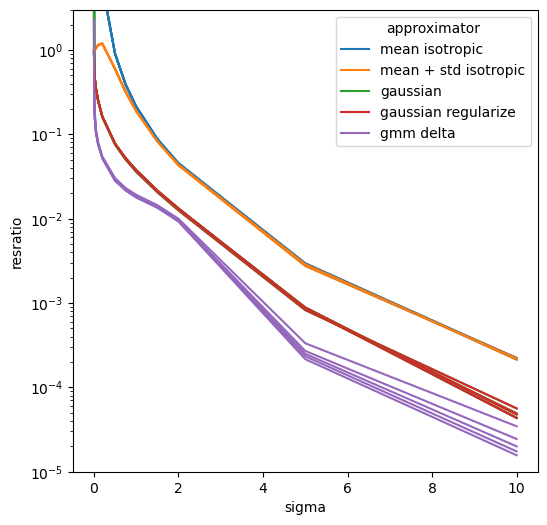

In [429]:
import seaborn as sns
plt.figure(figsize=(6, 6))
for epoch in [25000, 50000, 75000, 100000, 125000]:
    sns.lineplot(data=df[df.edm_epoch==epoch], x="sigma", y="resratio", 
                 hue="approximator",
                 legend=False if epoch != 25000 else True, )
plt.ylim([1E-5, 3])
# plt.xscale("log")
plt.yscale("log")
plt.show()


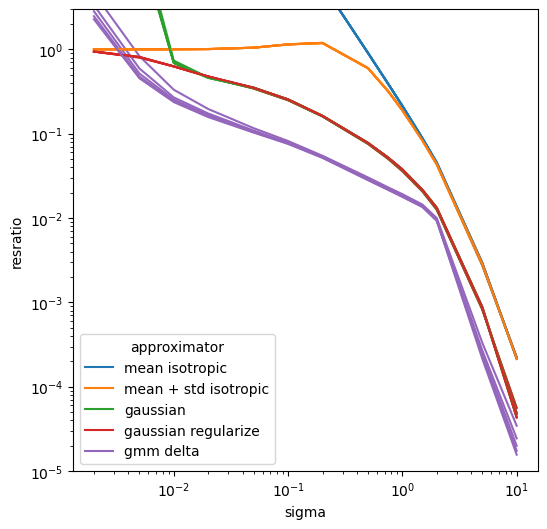

In [437]:
import seaborn as sns
plt.figure(figsize=(6, 6))
for epoch in [25000, 50000, 75000, 100000, 125000]:
    sns.lineplot(data=df[df.edm_epoch==epoch], x="sigma", y="resratio", 
                 hue="approximator",
                 legend=False if epoch != 25000 else True, )
plt.ylim([1E-5, 3])
plt.xscale("log")
plt.yscale("log")
plt.show()


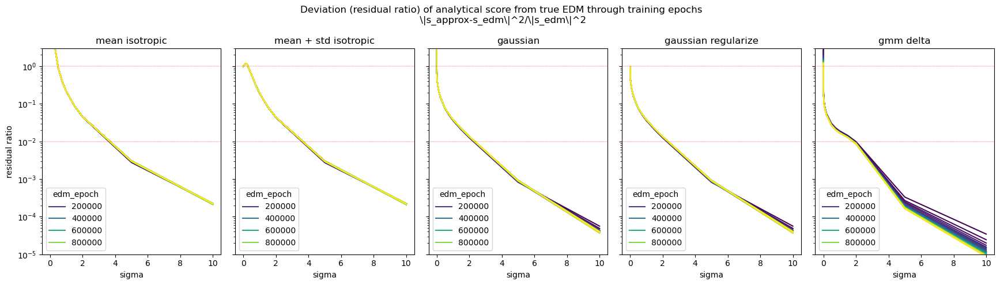

In [436]:
figh, axs = plt.subplots(1, 5,figsize=(17.5, 5), sharey=True, )
for i, approximator in enumerate(df.approximator.unique()):
    sns.lineplot(data=df[df.approximator==approximator], x="sigma", y="resratio", 
                    hue="edm_epoch", legend=True, palette="viridis", ax = axs[i])
    axs[i].set_title(approximator)
    axs[i].set_ylim([1E-5, 3])
    # plt.xscale("log")
    axs[i].set_yscale("log")
    axs[i].axhline(y=1E-2, color="red", linestyle="--", lw=0.3)
    axs[i].axhline(y=1, color="red", linestyle="--", lw=0.3)
    if i==0:
        axs[i].set_ylabel("residual ratio")
figh.suptitle("Deviation (residual ratio) of analytical score from true EDM through training epochs\n \|s_approx-s_edm\|^2/\|s_edm\|^2")
figh.tight_layout()
plt.show()

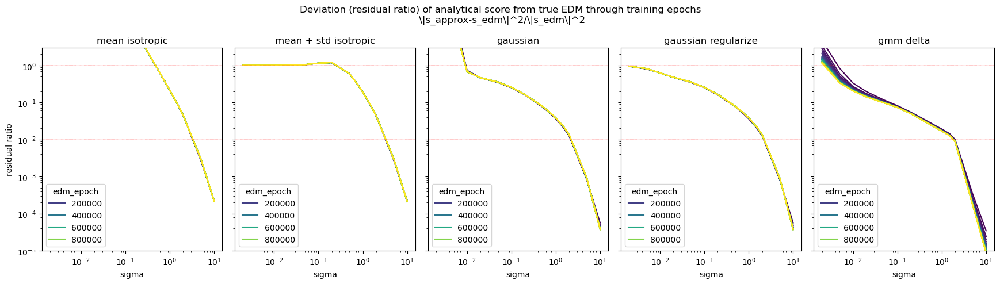

In [440]:
figh, axs = plt.subplots(1, 5,figsize=(17.5, 5), sharey=True, )
for i, approximator in enumerate(df.approximator.unique()):
    sns.lineplot(data=df[df.approximator==approximator], x="sigma", y="resratio", 
                    hue="edm_epoch", legend=True, palette="viridis", ax = axs[i])
    axs[i].set_title(approximator)
    axs[i].set_ylim([1E-5, 3])
    axs[i].set_xscale("log")
    axs[i].set_yscale("log")
    axs[i].axhline(y=1E-2, color="red", linestyle="--", lw=0.3)
    axs[i].axhline(y=1, color="red", linestyle="--", lw=0.3)
    if i==0:
        axs[i].set_ylabel("residual ratio")
figh.suptitle("Deviation (residual ratio) of analytical score from true EDM through training epochs\n \|s_approx-s_edm\|^2/\|s_edm\|^2")
figh.tight_layout()
plt.show()

In [ ]:
plt.figure(figsize=(6, 6))
# for epoch in [25000, 50000, 75000, 100000, 125000]:
sns.lineplot(data=df, x="sigma", y="resratio", 
                 hue="edm_epoch", color="purple", style="approximator", 
                 legend=True, palette="inferno", )
plt.ylim([1E-5, 3])
# plt.xscale("log")
plt.yscale("log")
plt.show()

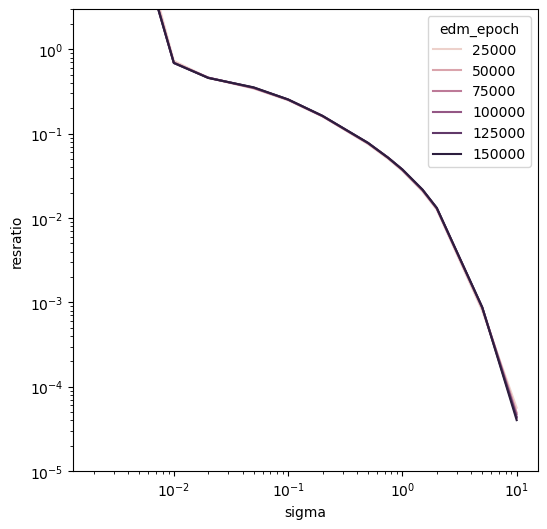

In [256]:
plt.figure(figsize=(6, 6))
# for epoch in [25000, 50000, 75000, 100000, 125000]:
sns.lineplot(data=df[df.approximator=="gaussian"], x="sigma", y="resratio", 
                 hue="edm_epoch", legend=True)
plt.ylim([1E-5, 3])
plt.xscale("log")
plt.yscale("log")
plt.show()

### Training Loss and FID

In [441]:
logfile = r"~/Github/mini_edm/exps/base_mnist_20240129-1342/std.log"


In [443]:
!pwd

/n/home12/binxuwang/Github/DiffusionMemorization/notebooks


In [445]:
import re
import pandas as pd

logfile = "/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/std.log"

# Define the regex pattern to extract the desired information
# pattern = r"(\d{4}-\d{2}-\d{2} \d{2}:\d{2}:\d{2}) - (\w+): (.*)"
pattern = r"(\d{4}-\d{2}-\d{2} \d{2}:\d{2}:\d{2})\s+(\w+)\s+-->\s+step:\s+(\d+),\s+current lr:\s+([\d.]+)\s+average loss:\s+([\d.]+);\s+batch loss:\s+([\d.]+)"

# Create empty lists to store the extracted information
timestamps = []
levels = []
messages = []
df_col = []
# Read the logfile line by line and extract the desired information
with open(logfile, "r") as file:
    for line in file:
        match = re.match(pattern, line)
        if match:
            timestamp = match.group(1)
            level = match.group(2)
            step = match.group(3)
            learning_rate = match.group(4)
            average_loss = match.group(5)
            batch_loss = match.group(6)
            df_col.append({"timestamp": timestamp, "level": level, "step": int(step),
                            "learning_rate": float(learning_rate), "average_loss": float(average_loss),
                            "batch_loss": float(batch_loss),})

# Create a pandas dataframe from the extracted information
df = pd.DataFrame(df_col)

# Display the dataframe
print(df.head())


             timestamp level  step  learning_rate  average_loss  batch_loss
0  2024-01-29 13:43:03  INFO     0        0.00000      1.833650    1.833650
1  2024-01-29 13:43:27  INFO   500        0.00002      1.697529    1.329292
2  2024-01-29 13:43:51  INFO  1000        0.00004      1.328696    0.695399
3  2024-01-29 13:44:15  INFO  1500        0.00006      1.073665    0.446776
4  2024-01-29 13:44:39  INFO  2000        0.00008      0.896503    0.295767


In [517]:
df.step[(df.batch_loss< 0.1)].min()

18000

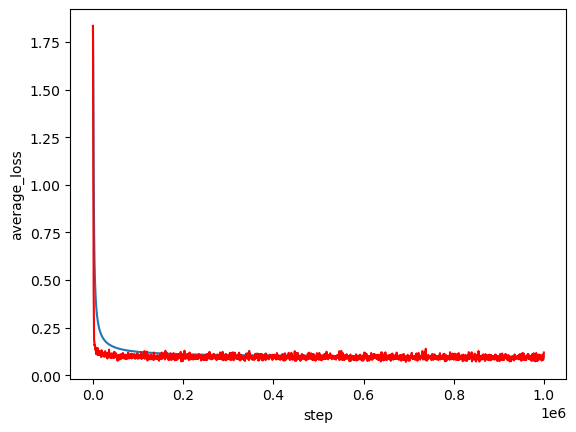

In [448]:
sns.lineplot(data=df, x="step", y="average_loss", legend=True)
sns.lineplot(data=df, x="step", y="batch_loss", legend=True, color="red")
plt.show()

## Visualize learned scores by projection

### Util functions for 2d slicing projection

In [476]:
class CoordSystem:
    
    def __init__(self, basis1, basis2, origin=None):
        # Ensure the basis vectors are normalized and orthogonal
        # if origin is None:
        #     origin = torch.zeros_like(basis1)
        self.reference = origin
        self.basis1 = basis1 / torch.norm(basis1)
        self.basis2 = basis2 / torch.norm(basis2)
        self.basis_matrix = torch.stack([self.basis1, self.basis2], dim=0)

    def project_vector(self, vectors):
        # Project a vector onto the basis using matrix algebra
        return (vectors @ self.basis_matrix.T)

    def ortho_project_vector(self, vectors):
        # Project a vector onto the perpendicular space of the basis using matrix algebra
        return vectors - (vectors @ self.basis_matrix.to(vectors.dtype).T) @ self.basis_matrix.to(vectors.dtype)
    
    def project_points(self, points):
        # Project a set of points onto the basis
        return (points - self.reference) @ self.basis_matrix.T


def orthogonal_grid(x1, x2, x3, grid_size):
    # Step 1: Find the Basis Vectors
    v1 = x2 - x1
    v = x3 - x1
    # Orthogonalize v with respect to v1 using the Gram-Schmidt process
    proj_v1_v = np.dot(v, v1) / np.dot(v1, v1) * v1
    v2 = v - proj_v1_v

    # Step 2: Normalize the Basis Vectors
    v1_normalized = v1 / np.linalg.norm(v1)
    v2_normalized = v2 / np.linalg.norm(v2)

    # Step 3: Create the Grid Points
    grid_points = []
    for i in range(grid_size):
        for j in range(grid_size):
            # Scaling factors for v1 and v2
            scale_v1 = i / (grid_size - 1)
            scale_v2 = j / (grid_size - 1)
            # Generate the grid point
            grid_point = x1 + scale_v1 * v1_normalized + scale_v2 * v2_normalized
            grid_points.append(grid_point)

    return np.array(grid_points)

def orthogonal_grid_torch(x1, x2, x3, grid_nums=(10, 10), 
                          x_range=(0, 1), y_range=(0, 1)):
    # Step 1: Find the Basis Vectors
    v1 = x2 - x1
    v = x3 - x1
    # Orthogonalize v with respect to v1 using the Gram-Schmidt process
    proj_v1_v = torch.dot(v, v1) / torch.dot(v1, v1) * v1
    v2 = v - proj_v1_v
    v1_norm = torch.norm(v1)
    v2_norm = torch.norm(v2)
    # Step 2: Normalize the Basis Vectors
    v1_normalized = v1 / v1_norm
    v2_normalized = v2 / v2_norm
    coordsys = CoordSystem(v1_normalized, v2_normalized, origin=x1)
    # Step 3: Create the Grid Points
    grid_vecs = []
    norm_coords = []
    plane_coords = []
    for ti in torch.linspace(x_range[0], x_range[1], grid_nums[0]):
        for tj in torch.linspace(y_range[0], y_range[1], grid_nums[1]):
            # Scaling factors for v1 and v2
            scale_v1 = ti * v1_norm
            scale_v2 = tj * v2_norm
            # Generate the grid point
            grid_vec = x1 + scale_v1 * v1_normalized + scale_v2 * v2_normalized
            grid_vecs.append(grid_vec)
            norm_coords.append([ti, tj])
            plane_coords.append([scale_v1, scale_v2])
    return torch.stack(grid_vecs), \
            torch.tensor(norm_coords), \
            torch.tensor(plane_coords), coordsys

In [467]:
torch.allclose(coordsys.ortho_project_vector(grid_vecs) + 
               coordsys.project_vector(grid_vecs) @ coordsys.basis_matrix, 
               grid_vecs, atol=1E-5)

True

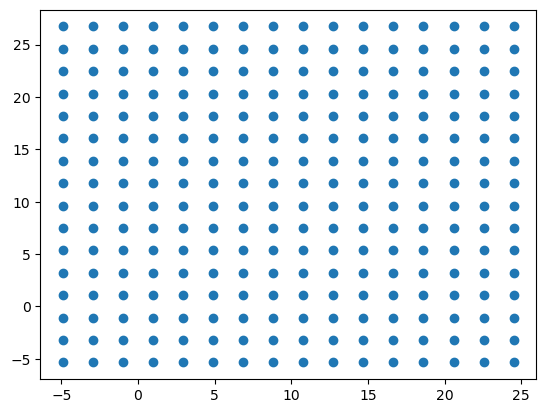

In [459]:
grid_vecs, norm_coords, plane_coords, coordsys = orthogonal_grid_torch(
        edm_Xmat[0, :], edm_Xmat[1, :], edm_Xmat[2, :], 
        grid_nums=(16, 16), x_range=(-0.25, 1.25), y_range=(-0.25, 1.25))
assert torch.allclose(plane_coords.cuda(), coordsys.project_points(grid_vecs))
plt.scatter(plane_coords[:, 0], plane_coords[:, 1])

In [278]:
# Compute score on the grid points
grid_vecs, norm_coords, plane_coords, coordsys = orthogonal_grid_torch(
        edm_Xmat[0, :], edm_Xmat[1, :], edm_Xmat[2, :], 
        grid_nums=(16, 16), x_range=(-0.25, 1.25), y_range=(-0.25, 1.25))
sigma = 0.2
edm_Dt = edm(grid_vecs.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
score_edm = (edm_Dt.view(grid_vecs.shape) - grid_vecs) / (sigma**2)

### Demo visualization

Score vector field among 3 random samples, [ 9869  3132 35459] labels [0 1 3]


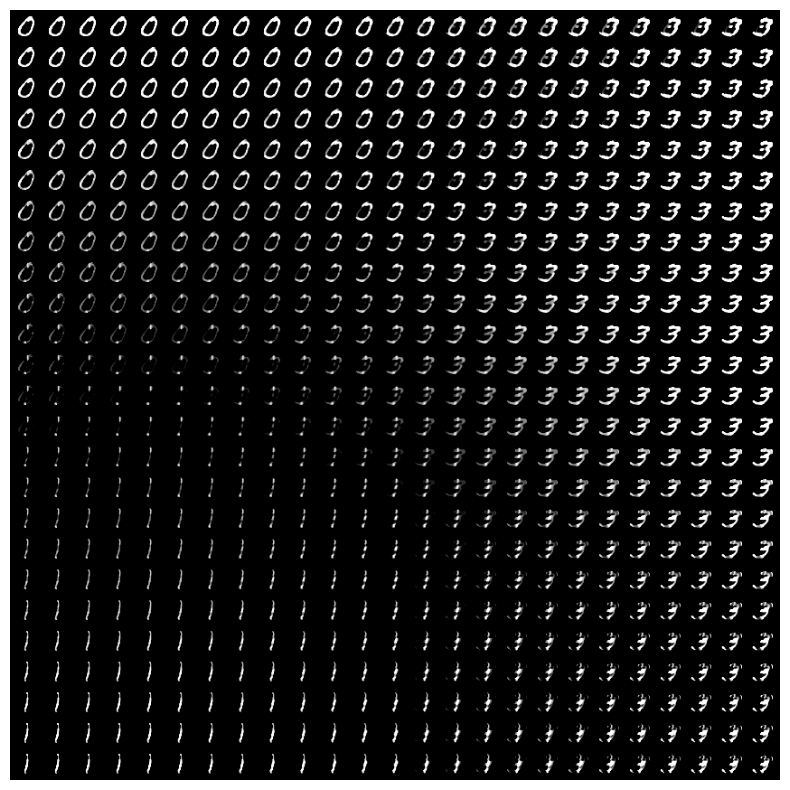

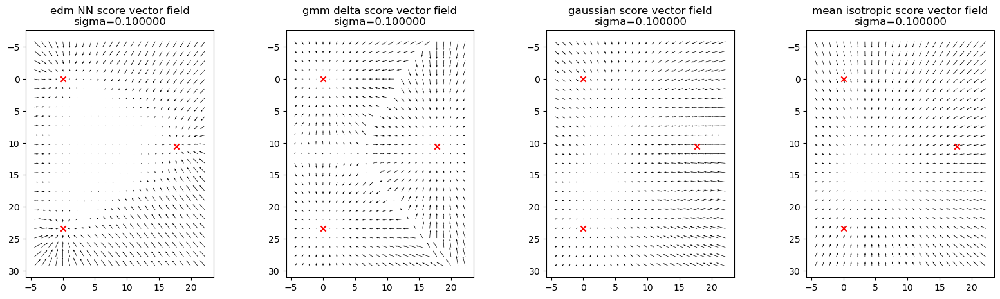

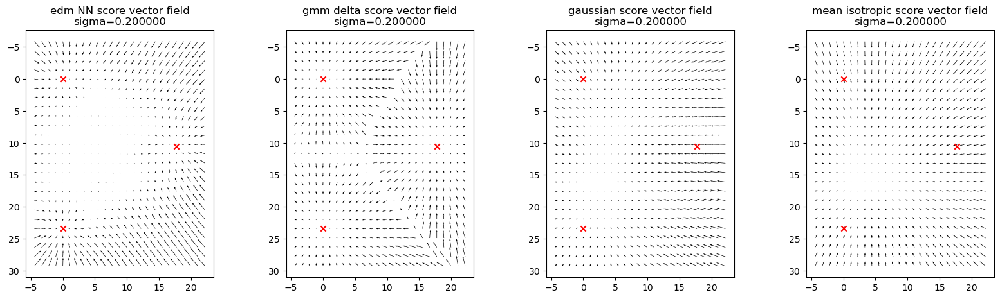

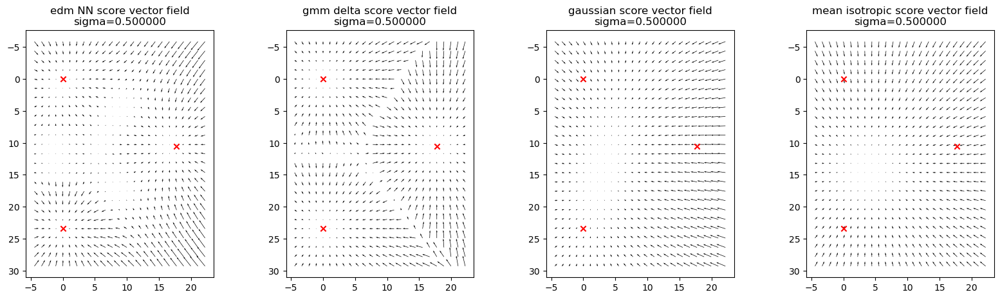

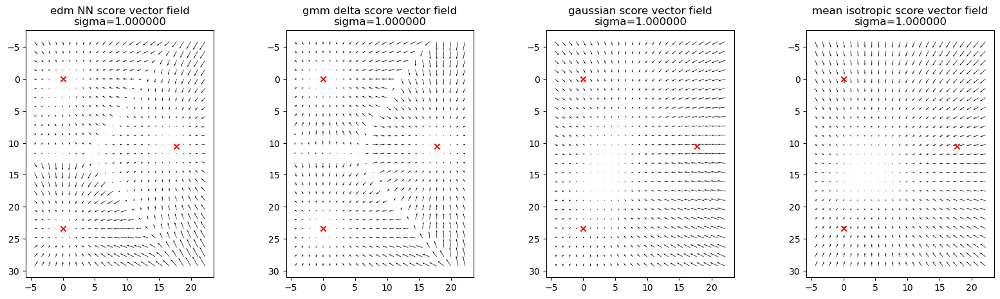

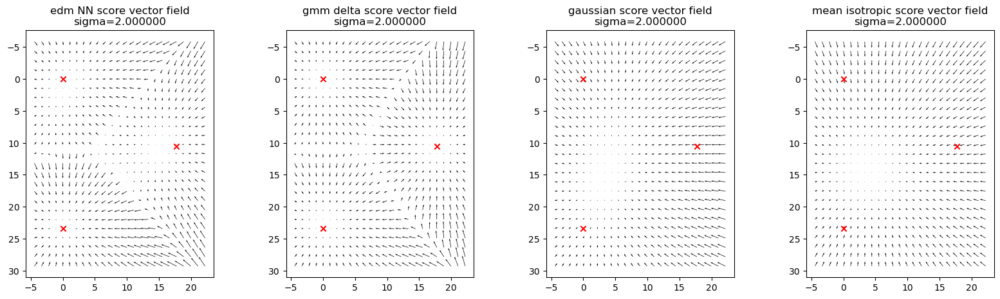

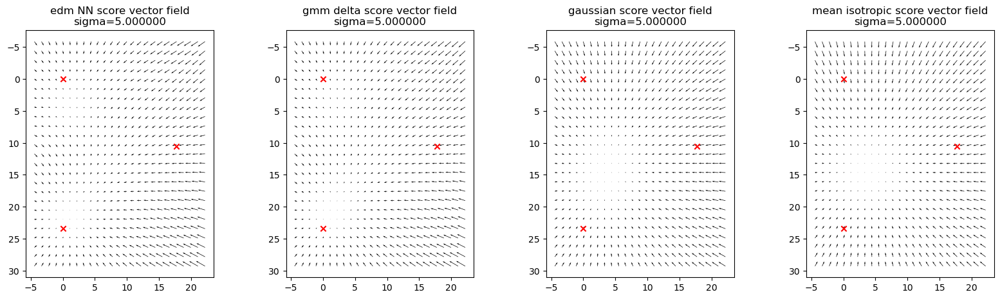

In [378]:
import matplotlib.pyplot as plt
idxs = np.random.choice(edm_Xmat.shape[0], 3, replace=False)
anchors = [edm_Xmat[idxs[0], :], edm_Xmat[idxs[1], :], edm_Xmat[idxs[2], :]]
anchors_tsr = torch.stack(anchors)
print(f"Score vector field among 3 random samples, {idxs} labels {ytsr[idxs].numpy()}")
grid_vecs, norm_coords, plane_coords, coordsys = orthogonal_grid_torch(
        *anchors, grid_nums=(25, 25), x_range=(-0.25, 1.25), y_range=(-0.25, 1.25))

mtg = make_grid(grid_vecs.reshape(-1, *edm_imgshape), nrow=25)
plt.figure(figsize=(10, 10))
plt.imshow(mtg.permute(1, 2, 0).cpu().numpy())
plt.axis('off')
plt.show()
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
for sigma in [0.1, 0.2, 0.5, 1.0, 2.0, 5.0]:
    edm_Dt = edm(grid_vecs.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(grid_vecs.shape) - grid_vecs) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    # score_gaussian1st_Xt = Gaussian_1stexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    # score_gaussian2nd_Xt = Gaussian_2ndexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(grid_vecs, edm_Xmat, sigma)
    # Calculate the vector field
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    for i, (name, vector_field) in enumerate([("edm NN", score_edm),
                        ("gmm delta", score_gmm_Xt),
                        ("gaussian", score_gaussian_Xt), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        ("mean isotropic", score_mean_Xt), 
                        # ("mean + std isotropic", score_mean_std_Xt), 
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ]):
        # Create a grid for the quiver plot
        vec_proj = coordsys.project_vector(vector_field).cpu().numpy()
        anchor_proj = coordsys.project_points(anchors_tsr).cpu().numpy()
        axs[i].invert_yaxis()
        axs[i].quiver(plane_coords[:, 1], plane_coords[:, 0], vec_proj[:, 1], vec_proj[:, 0], angles='xy')
        axs[i].scatter(anchor_proj[:, 1], anchor_proj[:, 0], color='r', marker='x')
        axs[i].set_aspect('equal')
        axs[i].set_title(name+f" score vector field\nsigma={sigma:f}")
    plt.show()


Score vector field among 3 random samples, [57481  1712   970] labels [8 0 5]


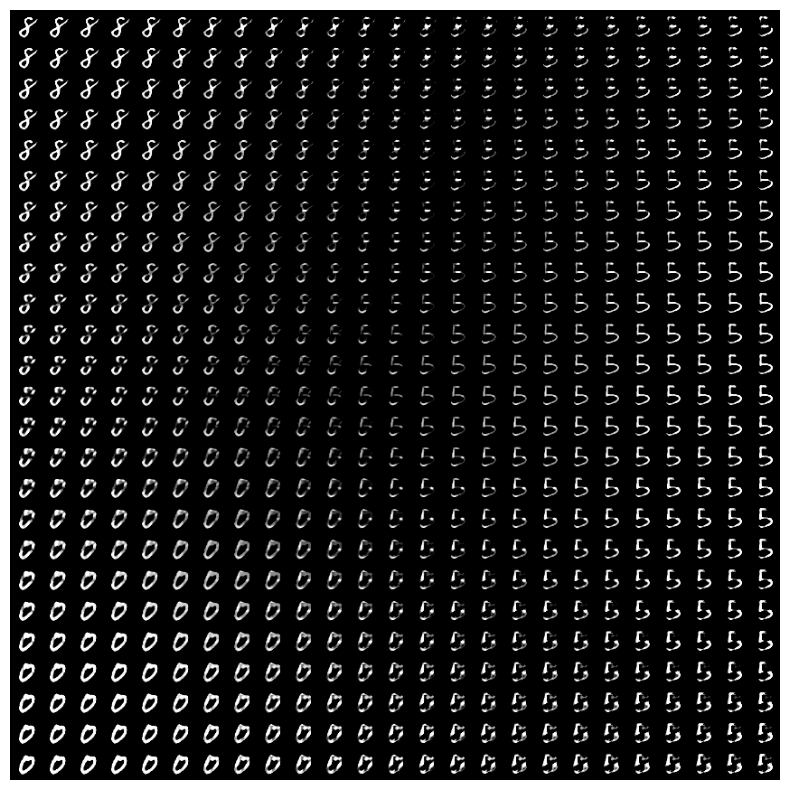

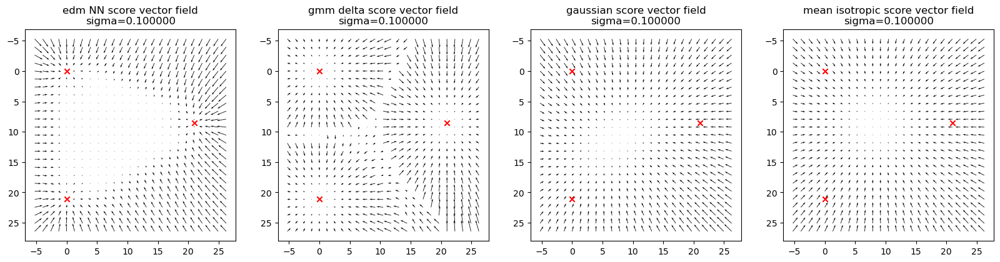

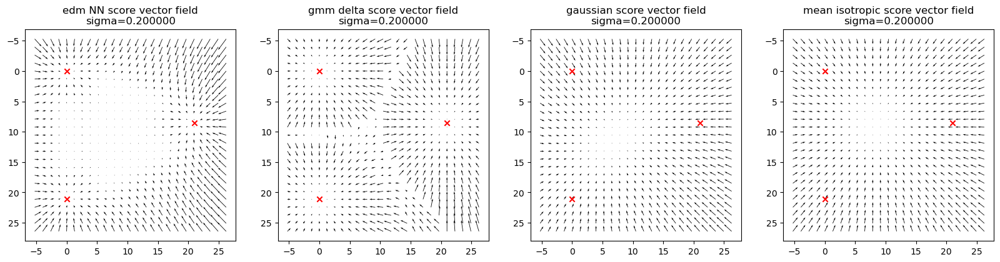

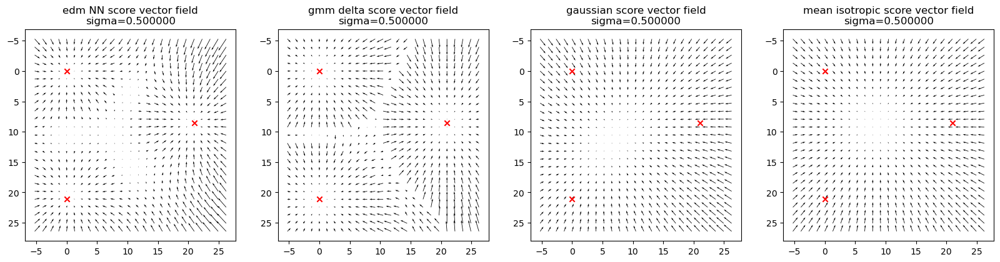

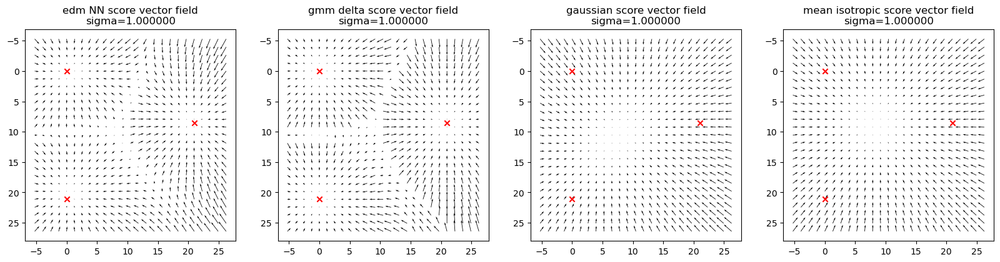

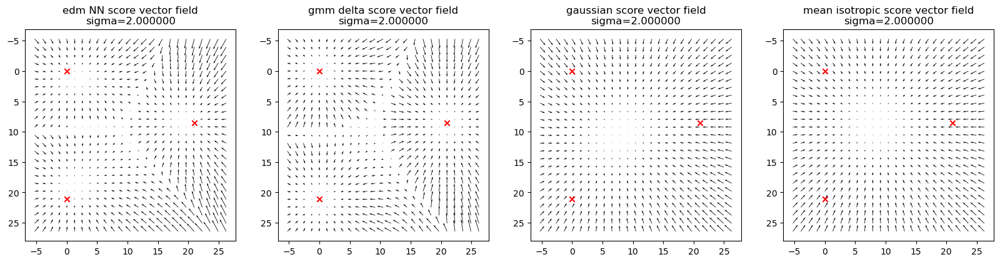

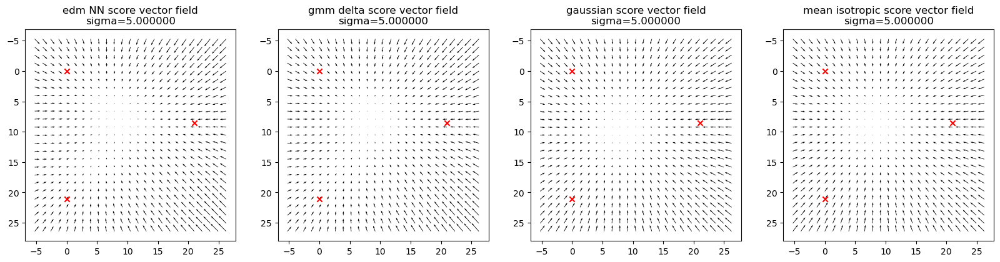

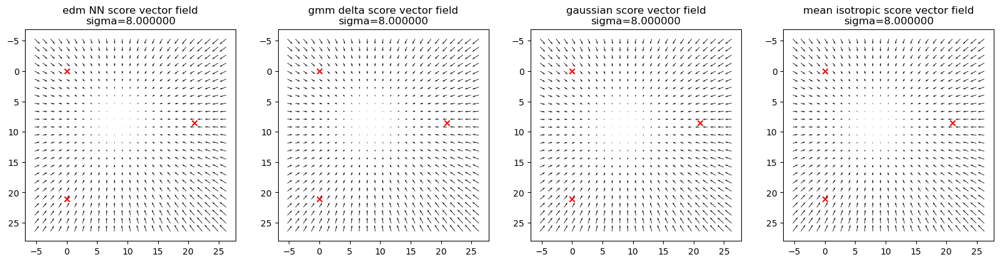

In [390]:
import matplotlib.pyplot as plt
idxs = np.random.choice(edm_Xmat.shape[0], 3, replace=False)
anchors = [edm_Xmat[idxs[0], :], edm_Xmat[idxs[1], :], edm_Xmat[idxs[2], :]]
anchors_tsr = torch.stack(anchors)
print(f"Score vector field among 3 random samples, {idxs} labels {ytsr[idxs].numpy()}")
grid_vecs, norm_coords, plane_coords, coordsys = orthogonal_grid_torch(
        *anchors, grid_nums=(25, 25), x_range=(-0.25, 1.25), y_range=(-0.25, 1.25))

mtg = make_grid(grid_vecs.reshape(-1, *edm_imgshape), nrow=25)
plt.figure(figsize=(10, 10))
plt.imshow(mtg.permute(1, 2, 0).cpu().numpy())
plt.axis('off')
plt.show()
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
for sigma in [0.1, 0.2, 0.5, 1.0, 2.0, 5.0, 8.0]:
    edm_Dt = edm(grid_vecs.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(grid_vecs.shape) - grid_vecs) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    # score_gaussian1st_Xt = Gaussian_1stexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    # score_gaussian2nd_Xt = Gaussian_2ndexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(grid_vecs, edm_Xmat, sigma)
    # Calculate the vector field
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    for i, (name, vector_field) in enumerate([("edm NN", score_edm),
                        ("gmm delta", score_gmm_Xt),
                        ("gaussian", score_gaussian_Xt), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        ("mean isotropic", score_mean_Xt), 
                        # ("mean + std isotropic", score_mean_std_Xt), 
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ]):
        # Create a grid for the quiver plot
        vec_proj = coordsys.project_vector(vector_field).cpu().numpy()
        anchor_proj = coordsys.project_points(anchors_tsr).cpu().numpy()
        axs[i].invert_yaxis()
        axs[i].quiver(plane_coords[:, 1], plane_coords[:, 0], vec_proj[:, 1], vec_proj[:, 0], angles='xy')
        axs[i].scatter(anchor_proj[:, 1], anchor_proj[:, 0], color='r', marker='x')
        axs[i].set_aspect('equal')
        axs[i].set_title(name+f" score vector field\nsigma={sigma:f}")
    plt.show()


Score vector field among 3 random samples, tensor([    0, 32248, 52295]) labels [5 5 5]


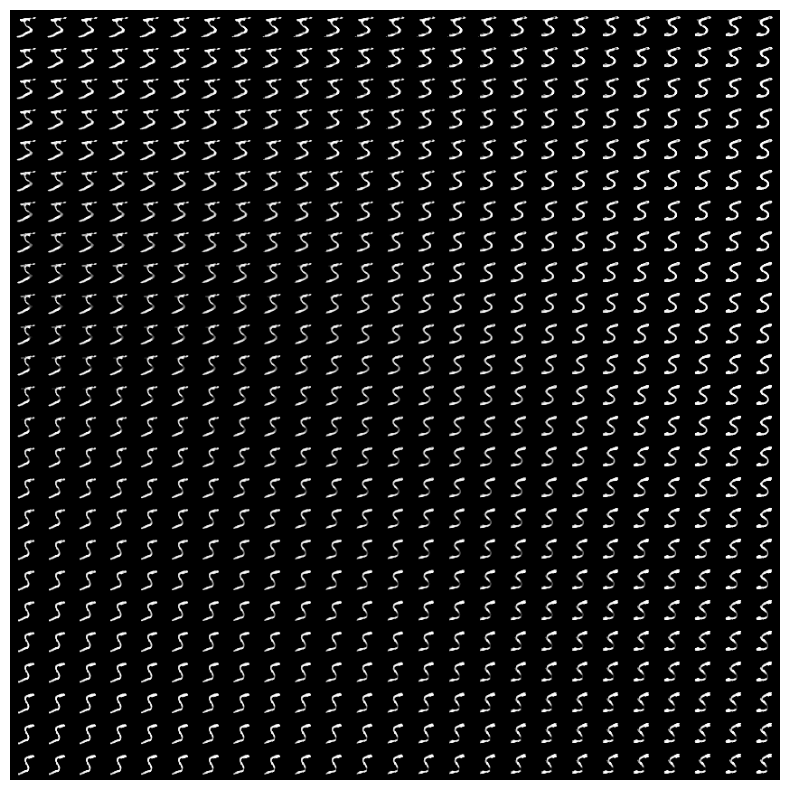

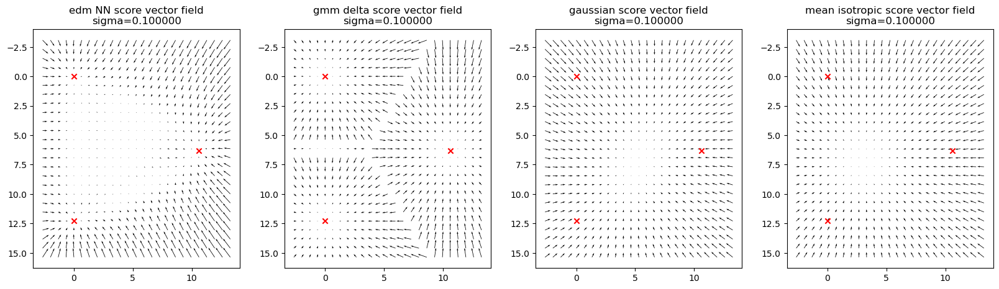

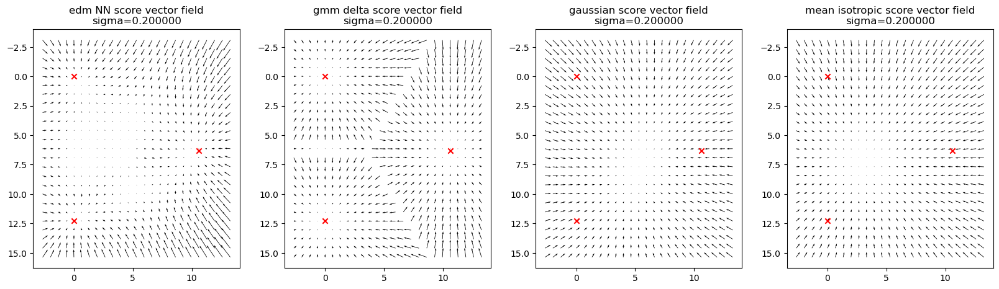

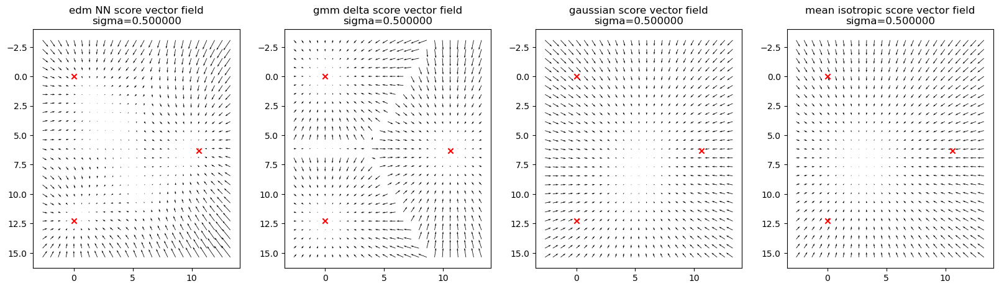

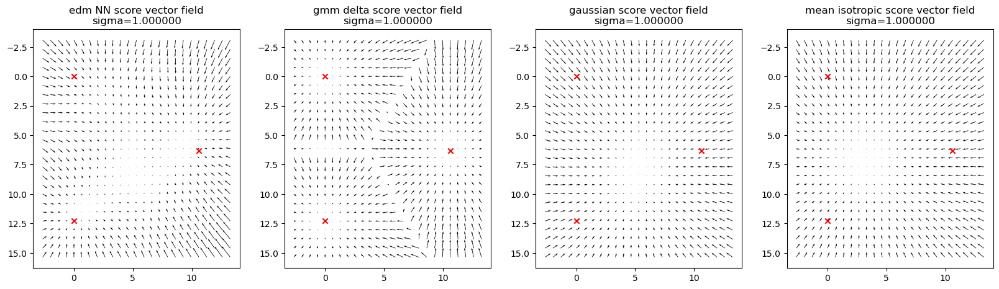

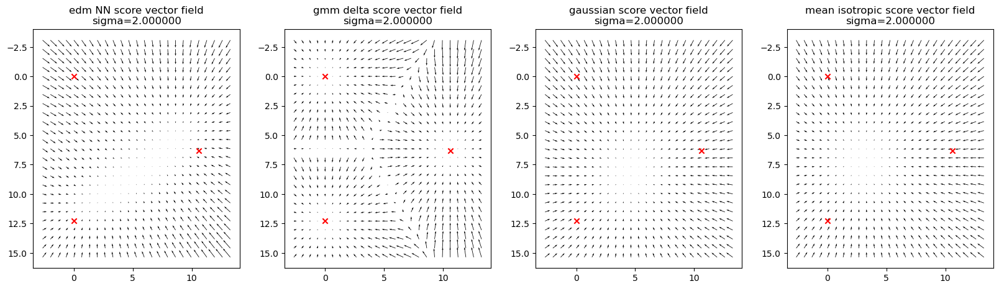

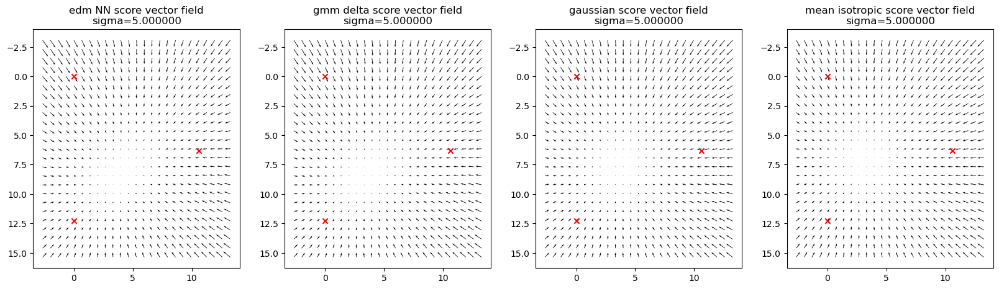

In [383]:
import matplotlib.pyplot as plt
dist2anchor = torch.cdist(edm_Xmat[0:1, :], edm_Xmat)
knndist, knnidx = torch.topk(dist2anchor, k=3, dim=-1, largest=False)
anchors = [edm_Xmat[knnidx[0,0], :], edm_Xmat[knnidx[0,1], :], edm_Xmat[knnidx[0,2], :]]
# anchors = [edm_Xmat[idxs[0], :], edm_Xmat[idxs[1], :], edm_Xmat[idxs[2], :]]
anchors_tsr = torch.stack(anchors)
print(f"Score vector field among 3 random samples, {knnidx[0].cpu()} labels {ytsr[knnidx[0].cpu()].numpy()}")
grid_vecs, norm_coords, plane_coords, coordsys = orthogonal_grid_torch(
        *anchors, grid_nums=(25, 25), x_range=(-0.25, 1.25), y_range=(-0.25, 1.25))

mtg = make_grid(grid_vecs.reshape(-1, *edm_imgshape), nrow=25)
plt.figure(figsize=(10, 10))
plt.imshow(mtg.permute(1, 2, 0).cpu().numpy())
plt.axis('off')
plt.show()
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
for sigma in [0.1, 0.2, 0.5, 1.0, 2.0, 5.0]:
    edm_Dt = edm(grid_vecs.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(grid_vecs.shape) - grid_vecs) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    # score_gaussian1st_Xt = Gaussian_1stexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    # score_gaussian2nd_Xt = Gaussian_2ndexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(grid_vecs, edm_Xmat, sigma)
    # Calculate the vector field
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    for i, (name, vector_field) in enumerate([("edm NN", score_edm),
                        ("gmm delta", score_gmm_Xt),
                        ("gaussian", score_gaussian_Xt), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        ("mean isotropic", score_mean_Xt), 
                        # ("mean + std isotropic", score_mean_std_Xt), 
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ]):
        # Create a grid for the quiver plot
        vec_proj = coordsys.project_vector(vector_field).cpu().numpy()
        anchor_proj = coordsys.project_points(anchors_tsr).cpu().numpy()
        axs[i].invert_yaxis()
        axs[i].quiver(plane_coords[:, 1], plane_coords[:, 0], vec_proj[:, 1], vec_proj[:, 0], angles='xy')
        axs[i].scatter(anchor_proj[:, 1], anchor_proj[:, 0], color='r', marker='x')
        axs[i].set_aspect('equal')
        axs[i].set_title(name+f" score vector field\nsigma={sigma:f}")
    plt.show()


In [331]:
epoch = 200000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")

### Visualization pipeline function

In [486]:
def score_slice_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape,
                           sigmas=[0.1, 0.2, 0.5, 1.0, 2.0, 5.0], titlestr="",
                           grid_nums=(25, 25), x_range=(-0.25, 1.25), y_range=(-0.25, 1.25)):
    anchors_tsr = torch.stack(anchors)
    grid_vecs, norm_coords, plane_coords, coordsys = orthogonal_grid_torch(
            *anchors, grid_nums=grid_nums, x_range=x_range, y_range=y_range)

    mtg = make_grid(grid_vecs.reshape(-1, *edm_imgshape), nrow=grid_nums[1])
    plt.figure(figsize=(10, 10))
    plt.imshow(mtg.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()
    for sigma in sigmas:
        edm_Dt = edm(grid_vecs.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
        score_edm = (edm_Dt.view(grid_vecs.shape) - grid_vecs) / (sigma**2)
        score_mean_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma)
        score_mean_std_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma, sigma0=edm_std_mean)
        score_gaussian_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
        score_gaussian_reg_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
        # score_gaussian1st_Xt = Gaussian_1stexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
        # score_gaussian2nd_Xt = Gaussian_2ndexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
        score_gmm_Xt = delta_GMM_score(grid_vecs, edm_Xmat, sigma)
        # Calculate the vector field
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))
        for i, (name, vector_field) in enumerate([("edm NN", score_edm),
                            ("gmm delta", score_gmm_Xt),
                            ("gaussian", score_gaussian_Xt), 
                            # ("gaussian regularize", score_gaussian_reg_Xt),
                            ("mean isotropic", score_mean_Xt), 
                            # ("mean + std isotropic", score_mean_std_Xt), 
                            # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                            # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                            ]):
            # Create a grid for the quiver plot
            vec_proj = coordsys.project_vector(vector_field).cpu().numpy()
            anchor_proj = coordsys.project_points(anchors_tsr).cpu().numpy()
            axs[i].invert_yaxis()
            axs[i].quiver(plane_coords[:, 1], plane_coords[:, 0], vec_proj[:, 1], vec_proj[:, 0], angles='xy')
            axs[i].scatter(anchor_proj[:, 1], anchor_proj[:, 0], color='r', marker='x')
            axs[i].set_aspect('equal')
            axs[i].set_title(name)
        plt.suptitle(f"score vector field {titlestr}\nsigma={sigma:f}")
        plt.show()

In [511]:
def score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="l2",
                           sigmas=[0.1, 0.2, 0.5, 1.0, 2.0, 5.0], titlestr="",
                           grid_nums=(25, 25), x_range=(-0.25, 1.25), y_range=(-0.25, 1.25),
                           show_image=True):
    anchors_tsr = torch.stack(anchors)
    grid_vecs, norm_coords, plane_coords, coordsys = orthogonal_grid_torch(
            *anchors, grid_nums=grid_nums, x_range=x_range, y_range=y_range)
    if show_image:
        mtg = make_grid(grid_vecs.reshape(-1, *edm_imgshape), nrow=grid_nums[1])
        plt.figure(figsize=(10, 10))
        plt.imshow(mtg.permute(1, 2, 0).cpu().numpy())
        plt.axis('off')
        plt.show()
    for sigma in sigmas:
        edm_Dt = edm(grid_vecs.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
        score_edm = (edm_Dt.view(grid_vecs.shape) - grid_vecs) / (sigma**2)
        score_mean_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma)
        score_mean_std_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma, sigma0=edm_std_mean)
        score_gaussian_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
        score_gaussian_reg_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
        # score_gaussian1st_Xt = Gaussian_1stexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
        # score_gaussian2nd_Xt = Gaussian_2ndexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
        score_gmm_Xt = delta_GMM_score(grid_vecs, edm_Xmat, sigma)
        # Calculate the vector field
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))
        for i, (name, vector_field) in enumerate([("edm NN", score_edm),
                            ("gmm delta", score_gmm_Xt),
                            ("gaussian", score_gaussian_Xt), 
                            # ("gaussian regularize", score_gaussian_reg_Xt),
                            ("mean isotropic", score_mean_Xt), 
                            # ("mean + std isotropic", score_mean_std_Xt), 
                            # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                            # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                            ]):
            # Create a grid for the quiver plot
            
            anchor_proj = coordsys.project_points(anchors_tsr).cpu().numpy()
            axs[i].invert_yaxis()
            if magnitude == "l2":
                vec_norm = torch.norm(vector_field, dim=-1).cpu().numpy()
            elif magnitude == "proj_l2":
                vec_proj = coordsys.project_vector(vector_field)
                vec_norm = torch.norm(vec_proj, dim=-1).cpu().numpy()
            elif magnitude == "ortho_l2":
                vec_ortho = coordsys.ortho_project_vector(vector_field.double())
                vec_norm = torch.norm(vec_ortho, dim=-1).cpu().numpy()
            # axs[i].quiver(plane_coords[:, 1], plane_coords[:, 0], vec_proj[:, 1], vec_proj[:, 0], angles='xy')
            im = axs[i].imshow(vec_norm.reshape(grid_nums), origin="lower", 
                          extent=[plane_coords[:, 1].min(), plane_coords[:, 1].max(), 
                                  plane_coords[:, 0].min(), plane_coords[:, 0].max(), ],
                          vmin=0, vmax=vec_norm.max())
            axs[i].scatter(anchor_proj[:, 1], anchor_proj[:, 0], color='r', marker='x')
            axs[i].invert_yaxis()
            axs[i].set_aspect('equal')
            axs[i].set_title(name)
            # add colorbar
            # divider = make_axes_locatable(axs[i])
            # cax = divider.append_axes("right", size="5%", pad=0.05)
            cbar = plt.colorbar(im, )
            # cbar.set_clim(0, vec_norm.max())
        plt.suptitle(f"score vector field {titlestr}\nsigma={sigma:f} magnitude={magnitude}")
        plt.show()

#### Off plane component of score vector

Score vector field among 3 random samples in TRAIN set, tensor([45472,   872, 27371]) labels [4 0 4]


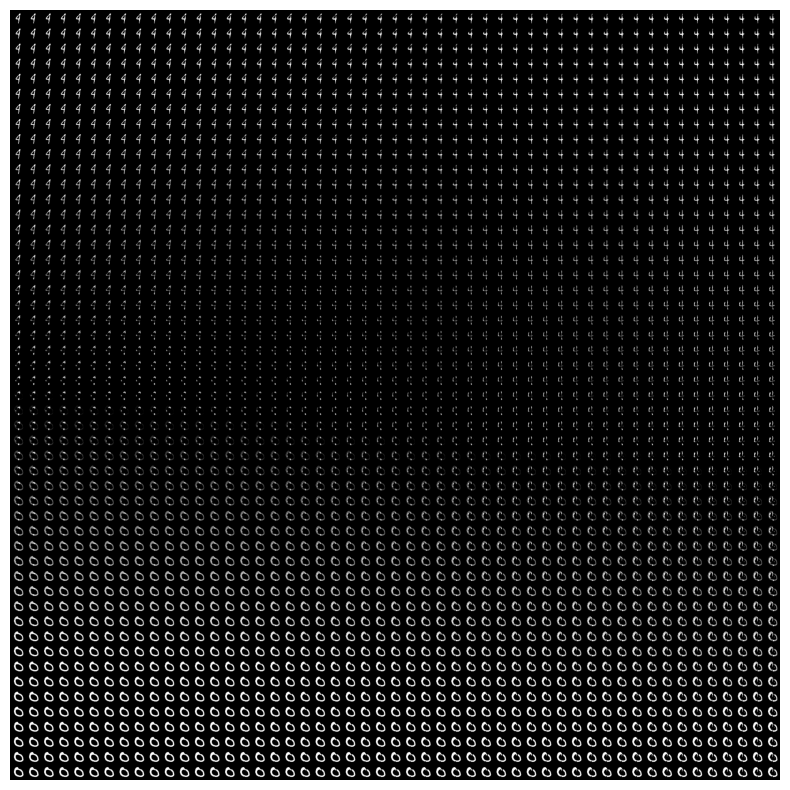

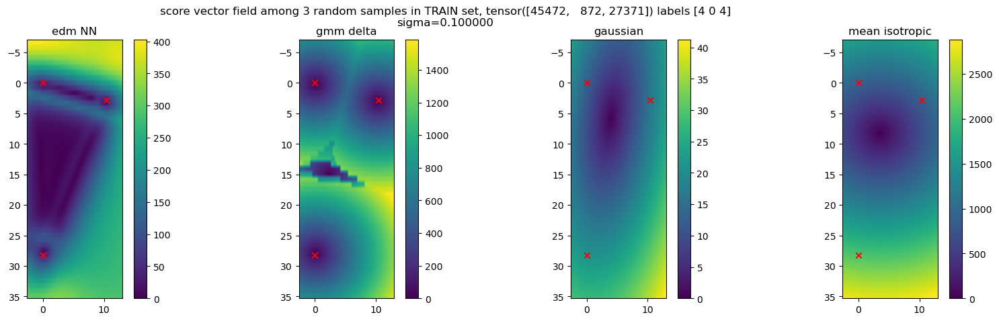

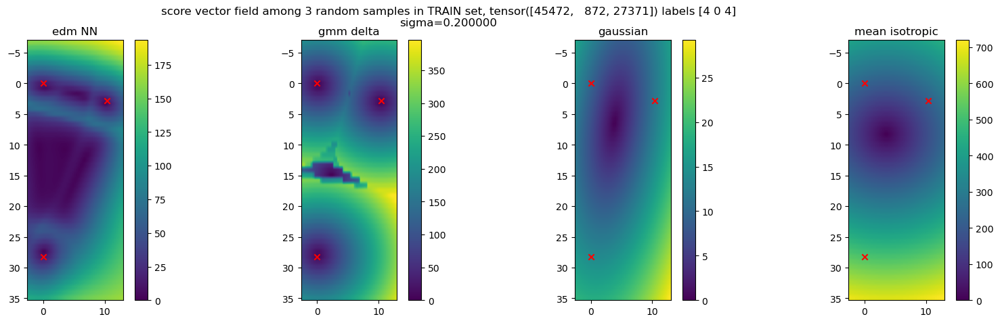

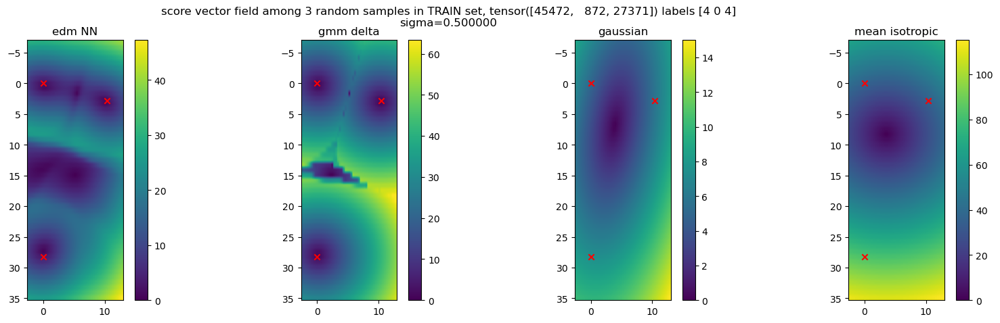

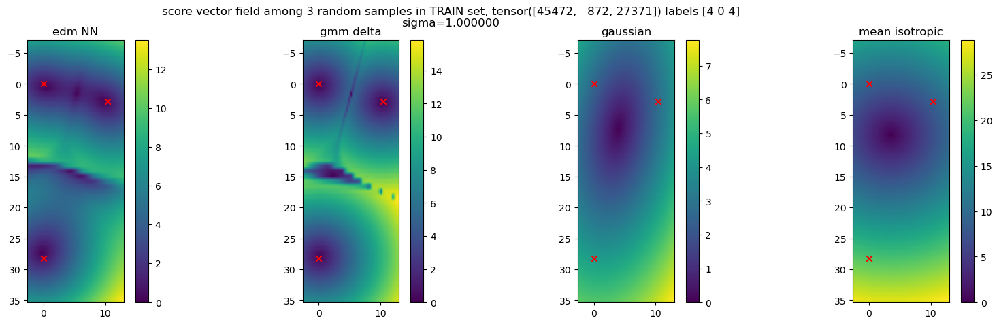

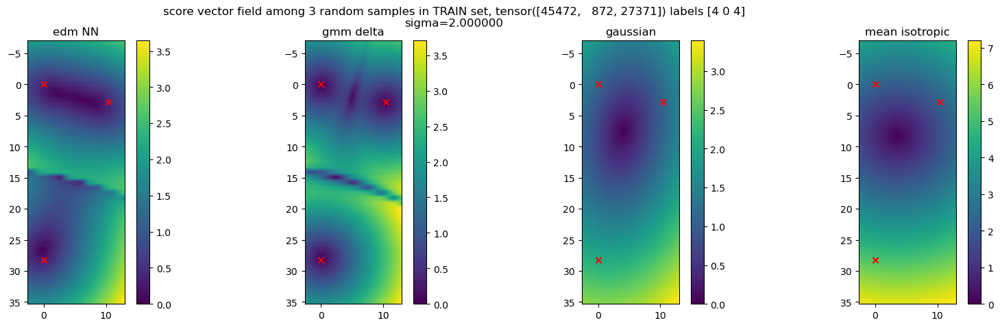

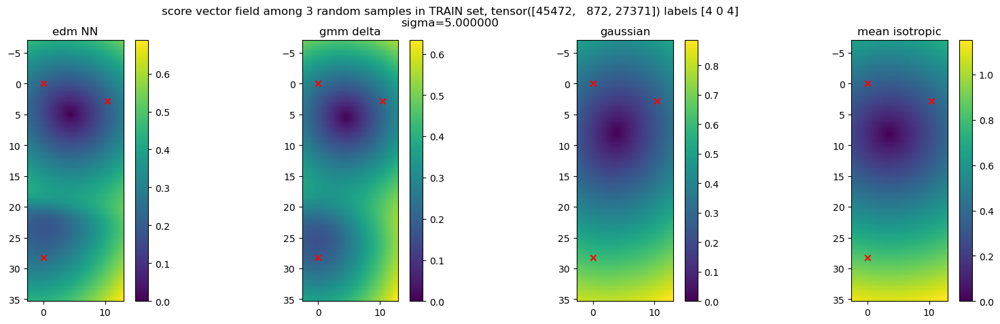

In [503]:
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
# knnidx = torch.randint(0, edm_Xmat.shape[0], (1, 3))
anchors = [edm_Xmat[knnidx[0,0], :], edm_Xmat[knnidx[0,1], :], edm_Xmat[knnidx[0,2], :]]
titlestr = f"among 3 random samples in TRAIN set, {knnidx[0].cpu()} labels {ytsr[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="proj_l2",
                       titlestr=titlestr, grid_nums=(51, 51), )

Score vector field among 3 random samples in TRAIN set, tensor([41015, 28775,  7592]) labels [3 7 5]


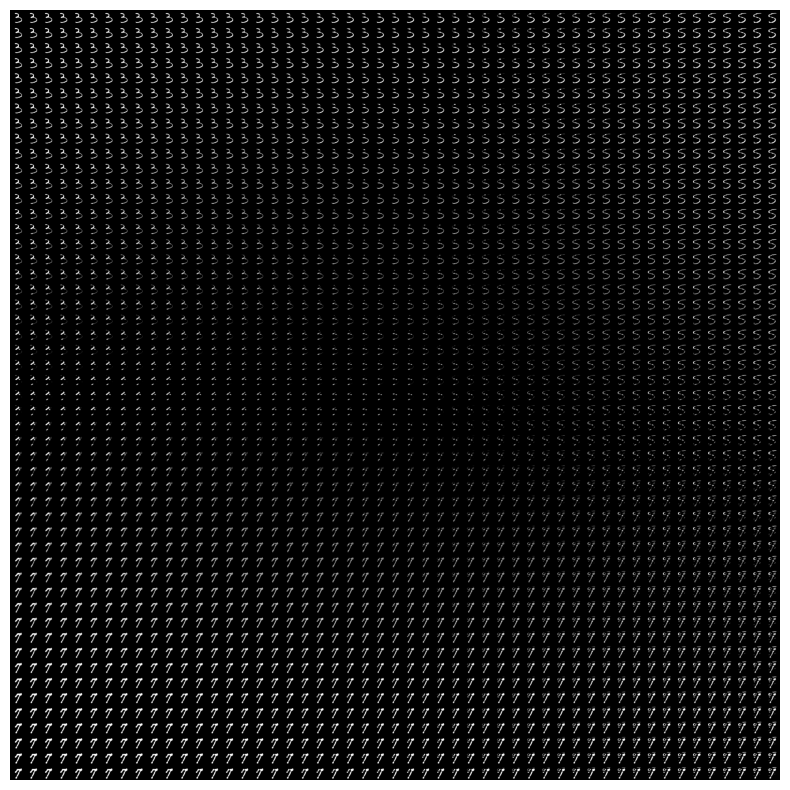

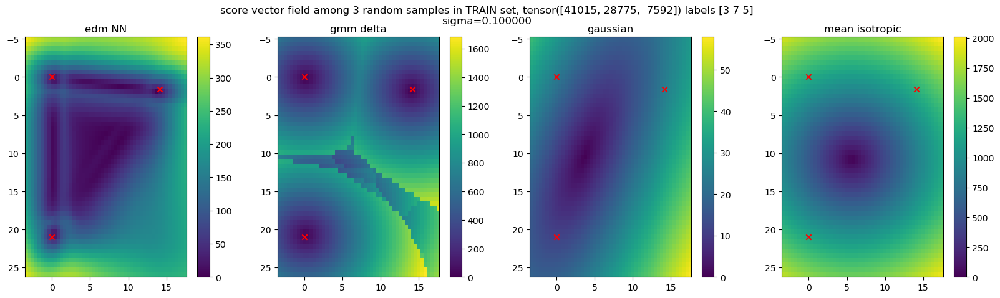

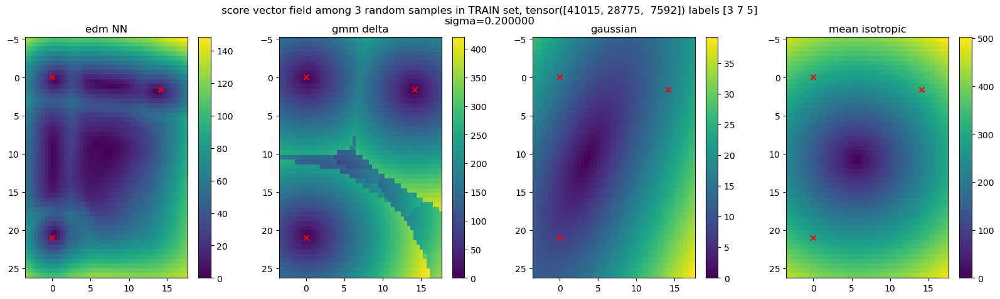

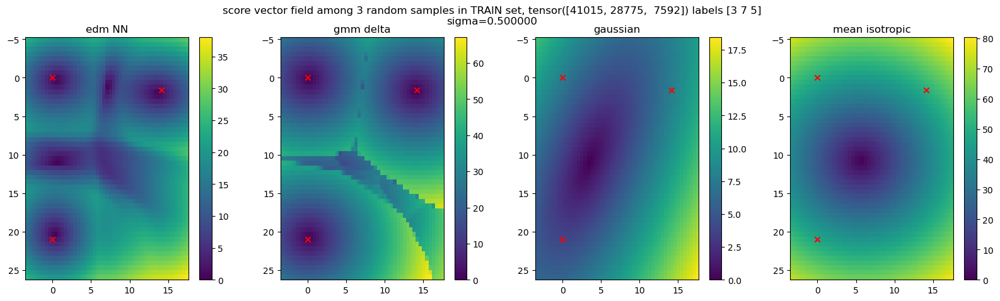

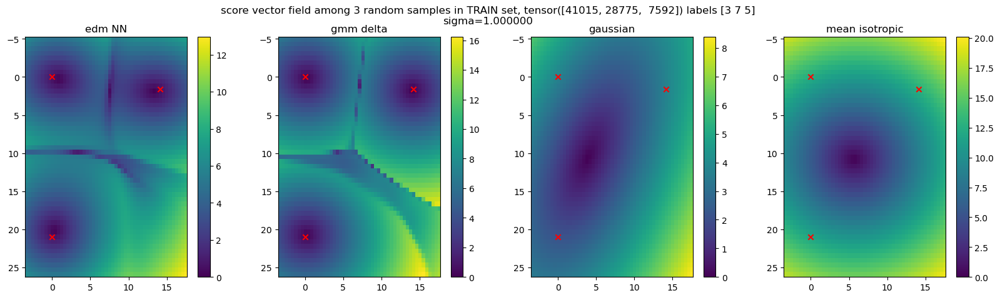

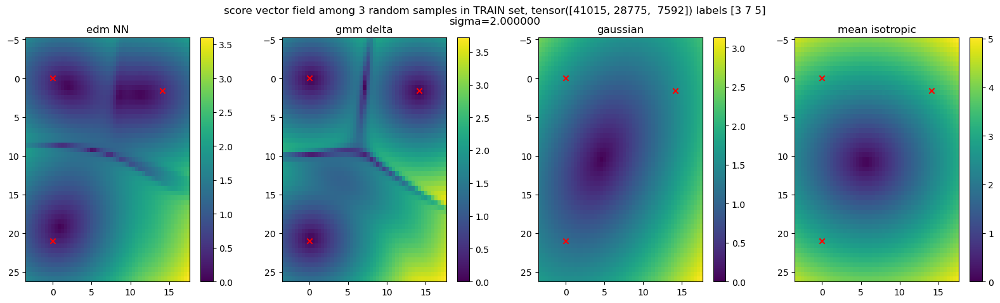

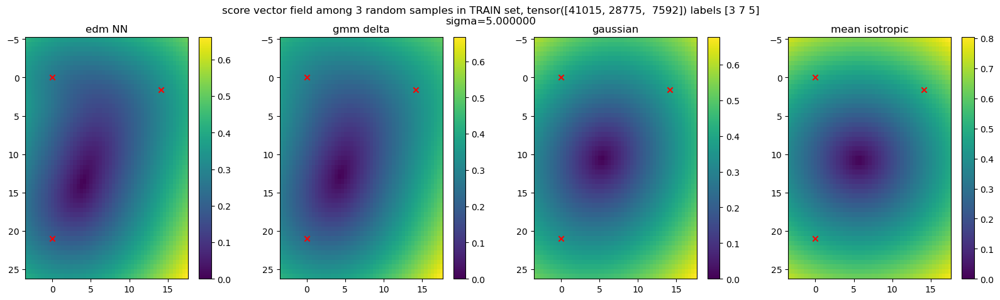

In [504]:
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
# knnidx = torch.randint(0, edm_Xmat.shape[0], (1, 3))
anchors = [edm_Xmat[knnidx[0,0], :], edm_Xmat[knnidx[0,1], :], edm_Xmat[knnidx[0,2], :]]
titlestr = f"among 3 random samples in TRAIN set, {knnidx[0].cpu()} labels {ytsr[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="proj_l2",
                       titlestr=titlestr, grid_nums=(51, 51), )

Score vector field among 3 random samples in TRAIN set, tensor([41015, 28775,  7592]) labels [3 7 5]


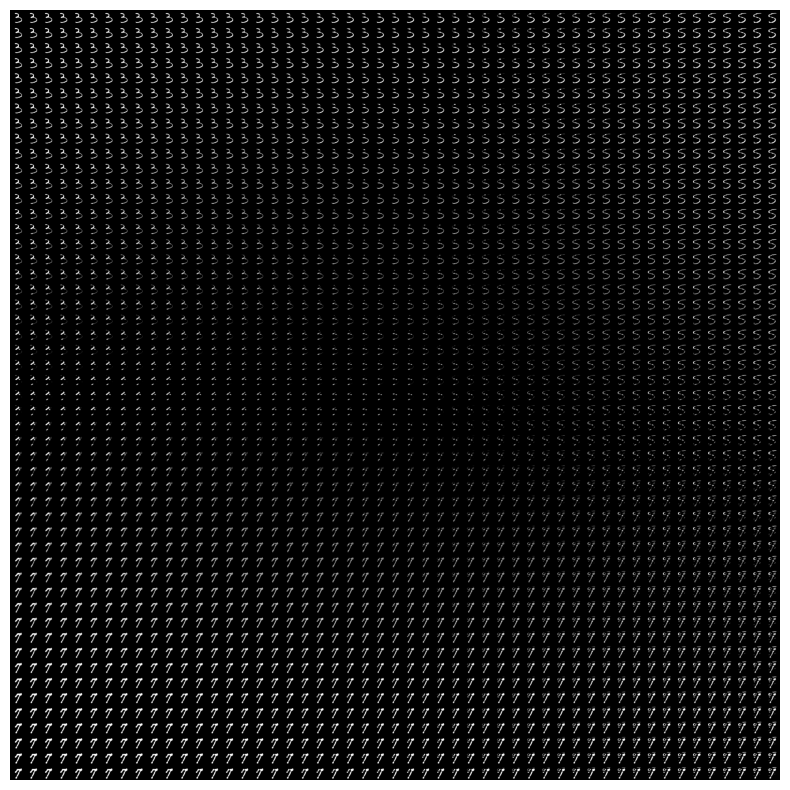

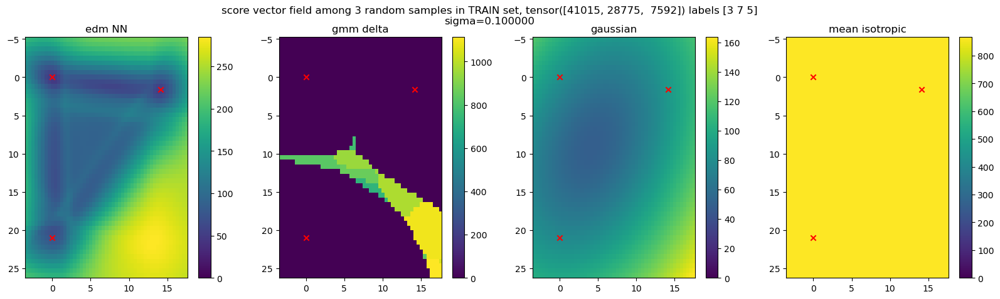

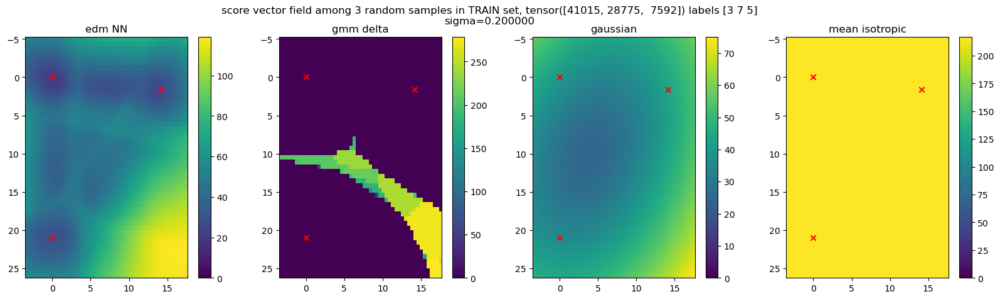

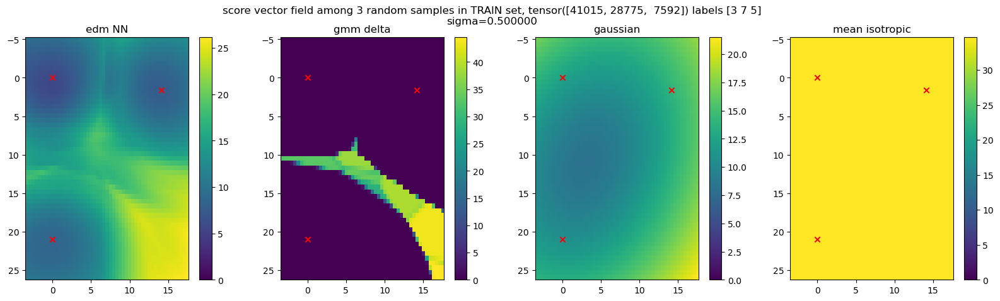

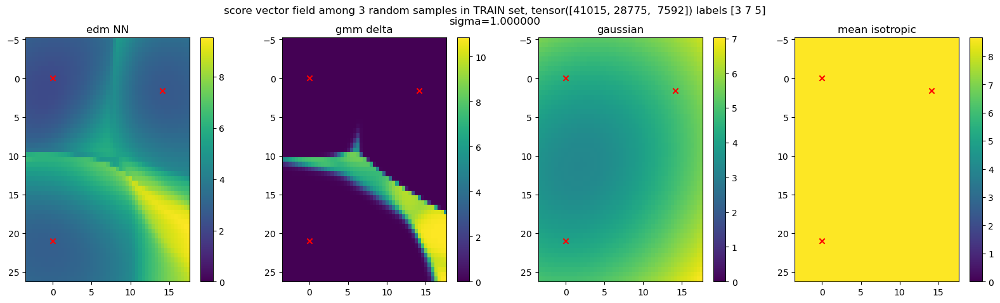

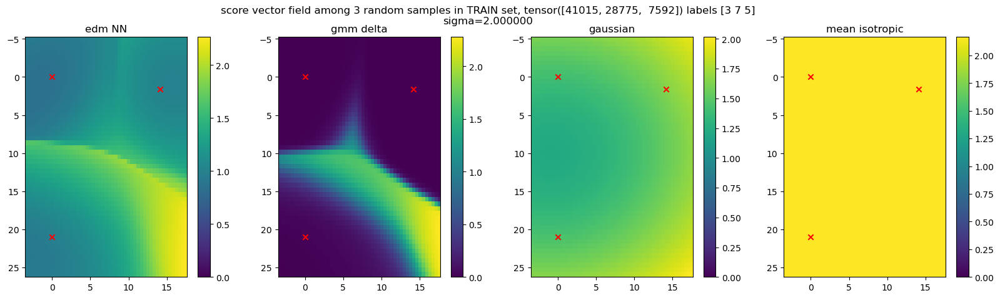

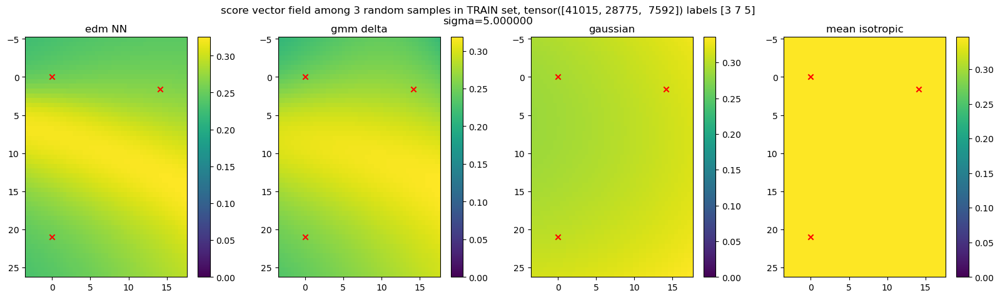

In [506]:
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
# knnidx = torch.randint(0, edm_Xmat.shape[0], (1, 3))
anchors = [edm_Xmat[knnidx[0,0], :], edm_Xmat[knnidx[0,1], :], edm_Xmat[knnidx[0,2], :]]
titlestr = f"among 3 random samples in TRAIN set, {knnidx[0].cpu()} labels {ytsr[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="ortho_l2",
                       titlestr=titlestr, grid_nums=(51, 51), )

Score vector field among 3 nearest samples in TEST set, tensor([  12, 6411, 5671]) labels [9 9 9]


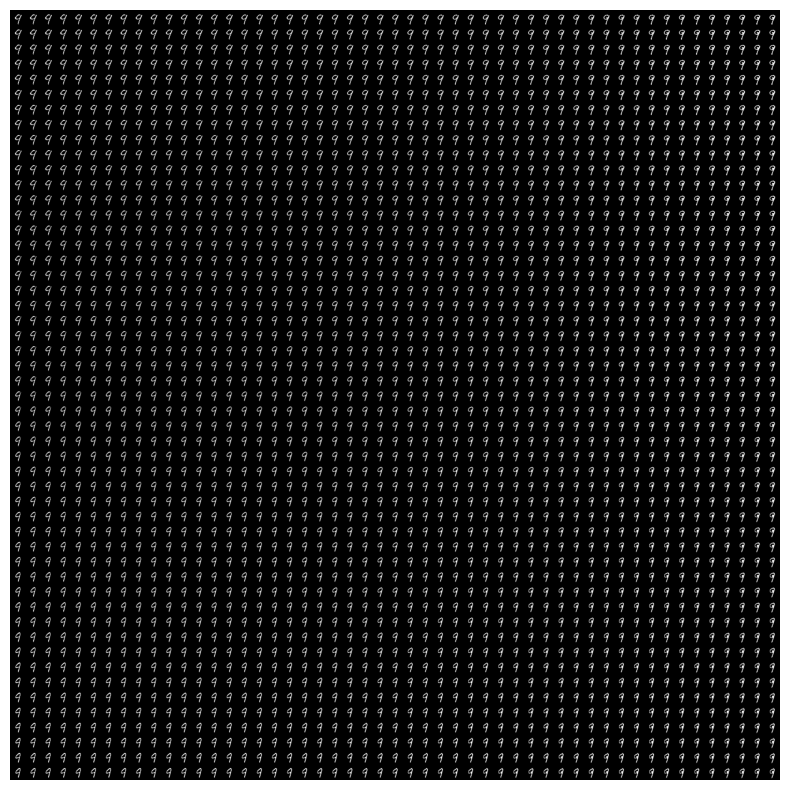

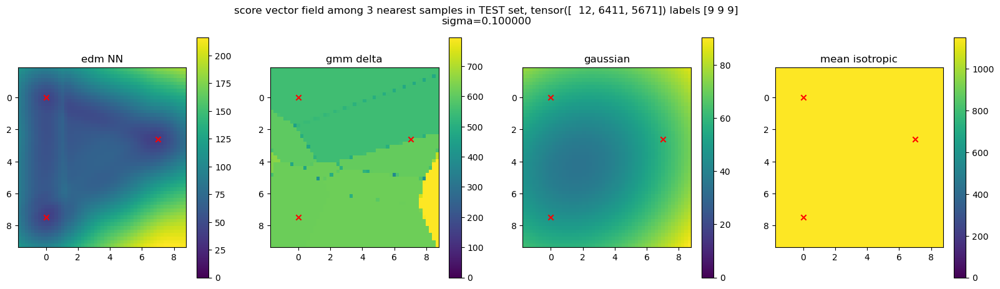

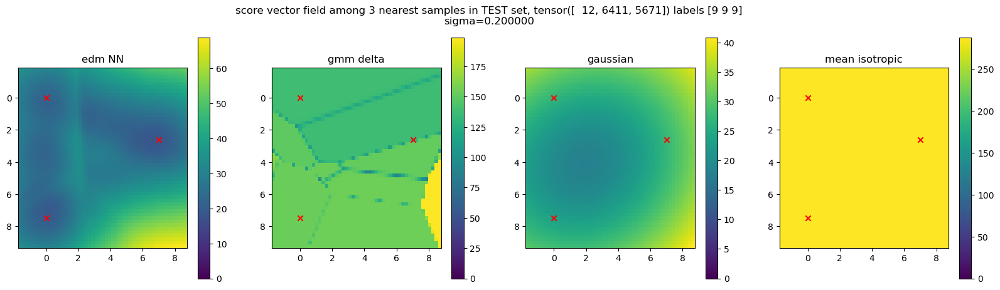

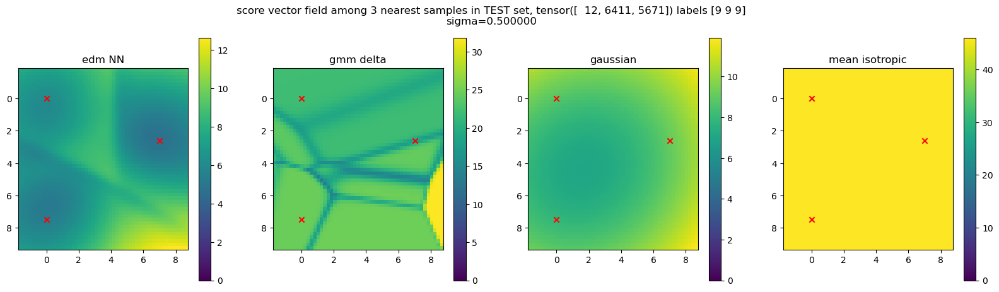

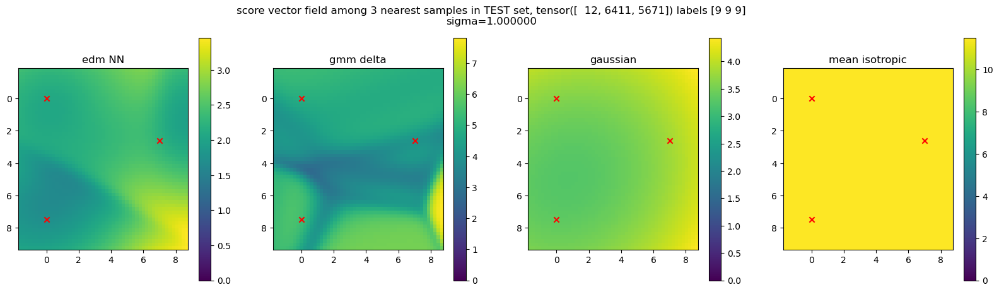

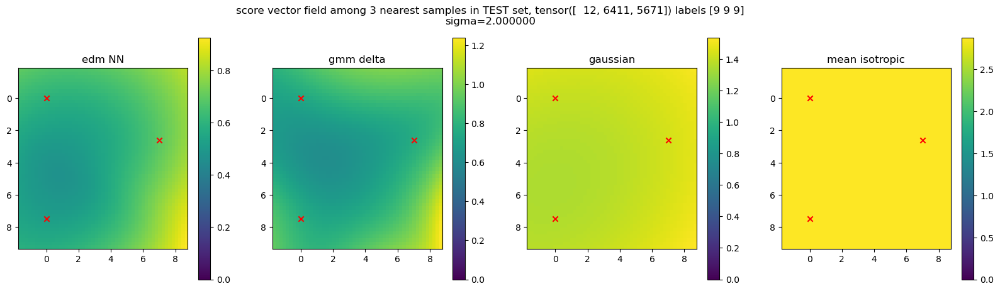

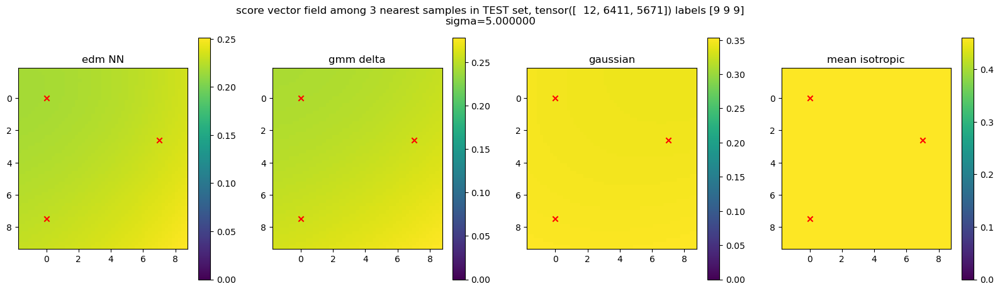

In [507]:
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
dist2anchor = torch.cdist(edm_Xmat_test[12:13, :], edm_Xmat_test)
knndist, knnidx = torch.topk(dist2anchor, k=3, dim=-1, largest=False)
anchors = [edm_Xmat_test[knnidx[0,0], :], edm_Xmat_test[knnidx[0,1], :], edm_Xmat_test[knnidx[0,2], :]]
titlestr = f"among 3 nearest samples in TEST set, {knnidx[0].cpu()} labels {ytsr_test[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="ortho_l2",
                       titlestr=titlestr, grid_nums=(51, 51), )

Score vector field among 3 nearest samples in TRAIN set, tensor([   10, 41428, 58483]) labels [3 3 3]


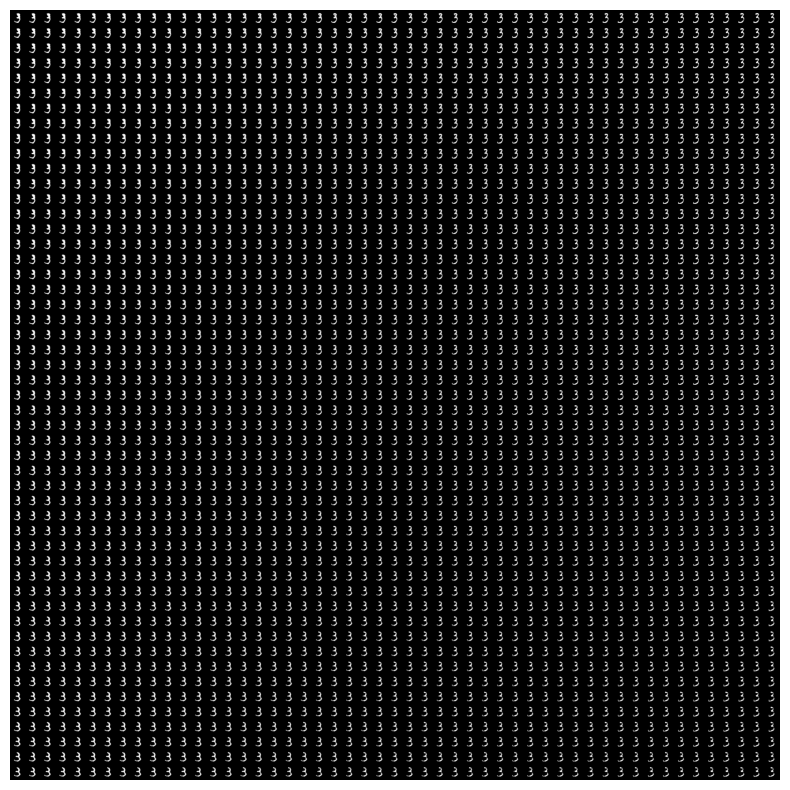

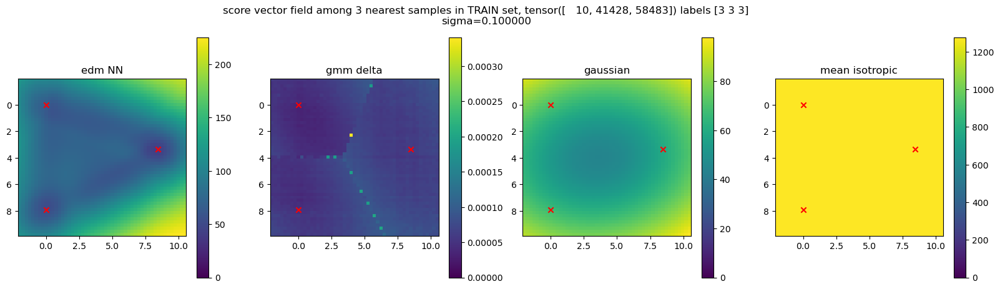

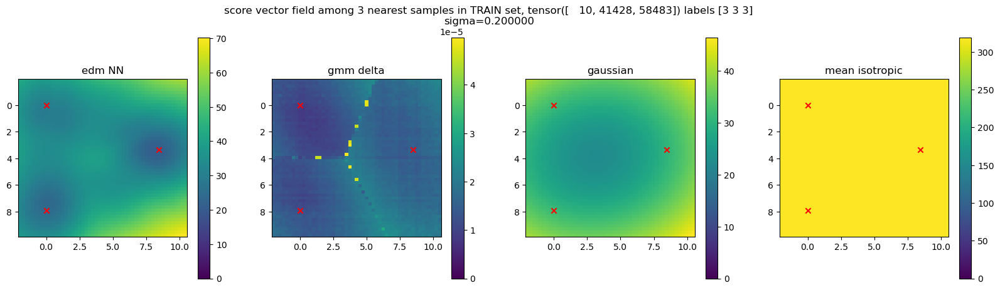

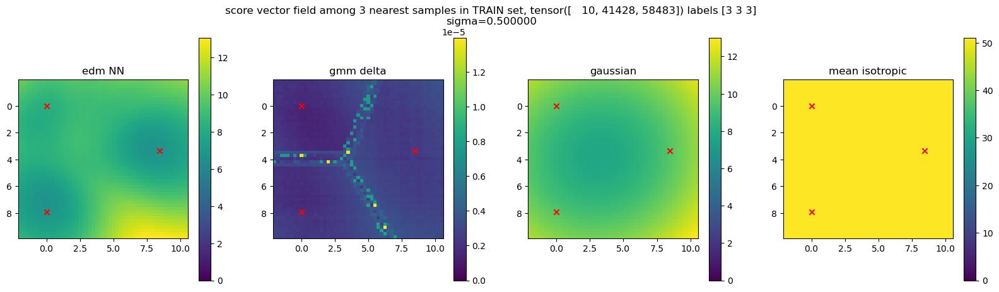

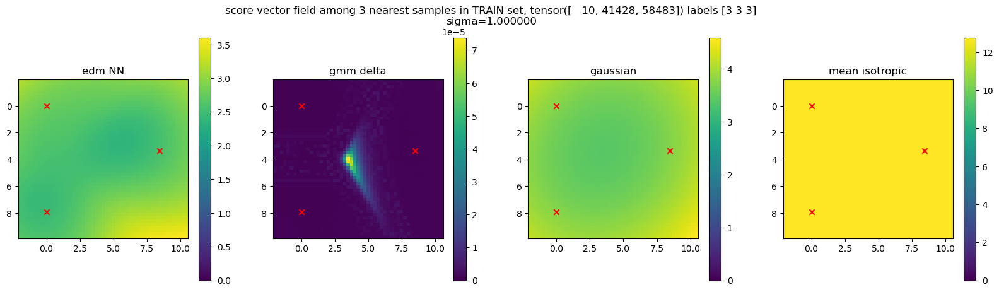

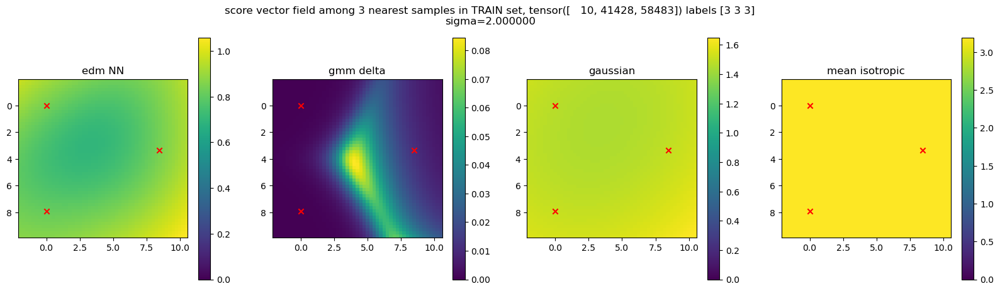

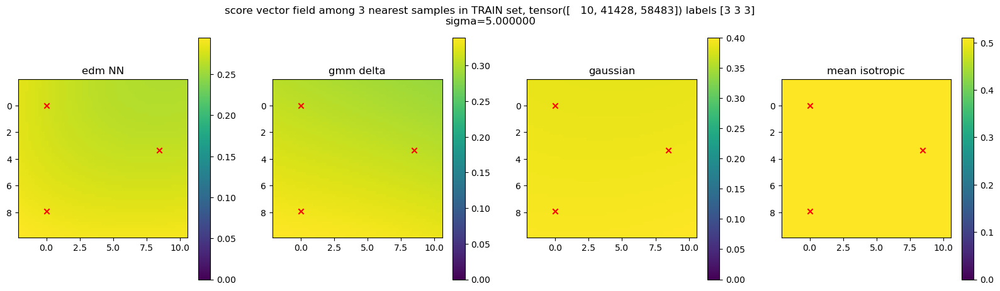

In [508]:
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
dist2anchor = torch.cdist(edm_Xmat[10:11, :], edm_Xmat)
knndist, knnidx = torch.topk(dist2anchor, k=3, dim=-1, largest=False)
anchors = [edm_Xmat[knnidx[0,0], :], edm_Xmat[knnidx[0,1], :], edm_Xmat[knnidx[0,2], :]]
titlestr = f"among 3 nearest samples in TRAIN set, {knnidx[0].cpu()} labels {ytsr[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="ortho_l2",
                       titlestr=titlestr, grid_nums=(51, 51), )


#### Training set, 3 Random samples 

Score vector field among 3 random samples in TRAIN set, tensor([50150, 27087, 37020]) labels [1 9 2]


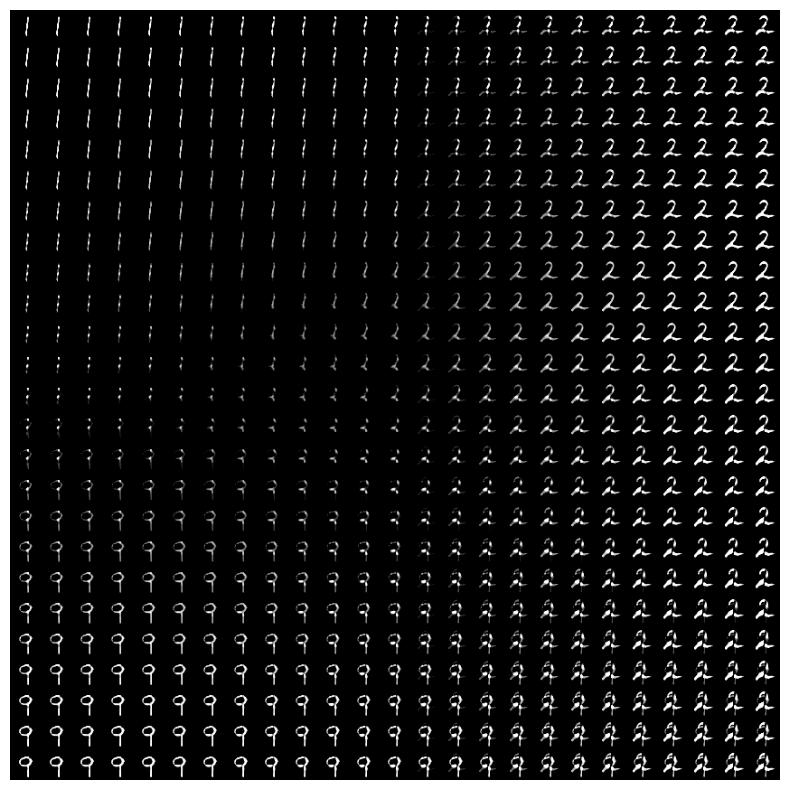

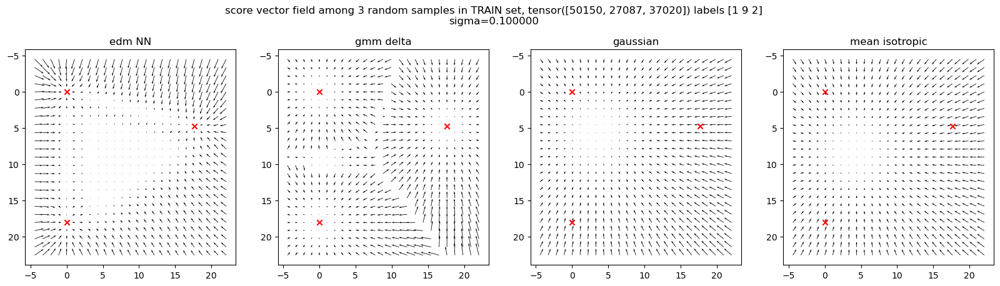

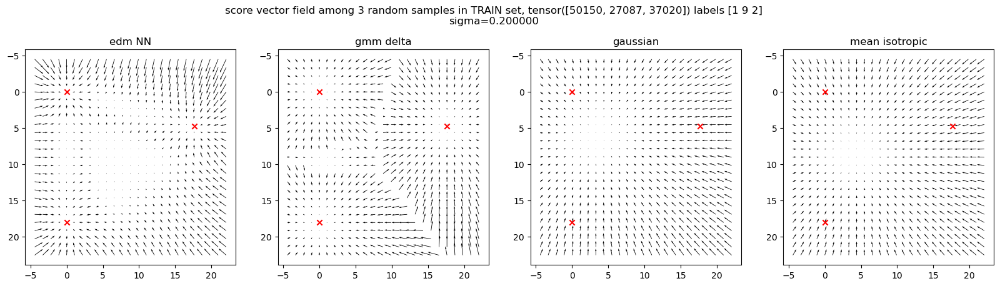

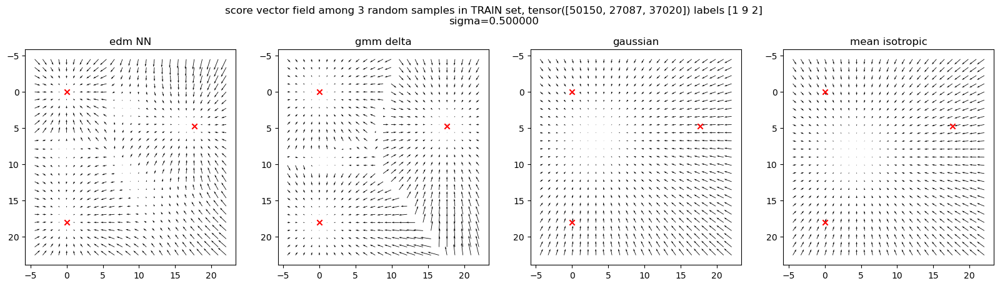

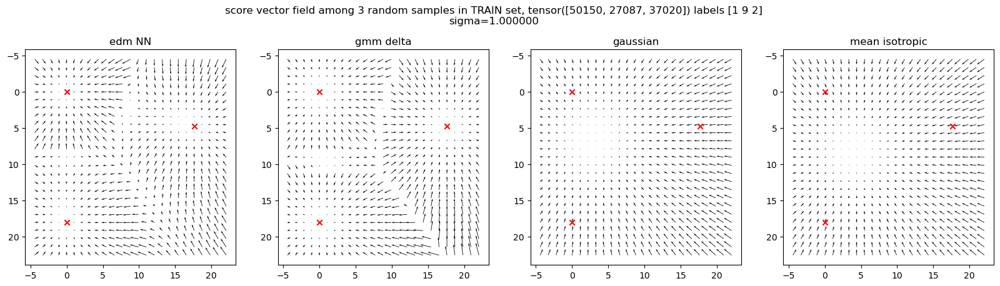

...

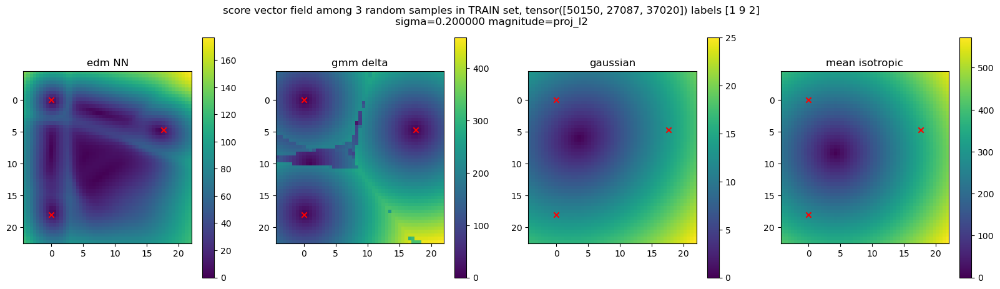

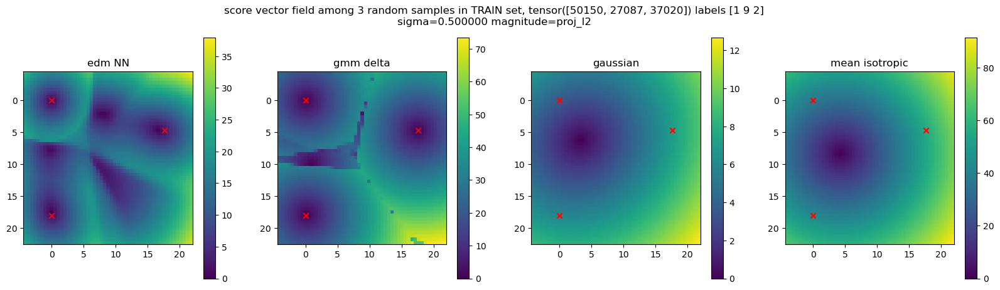

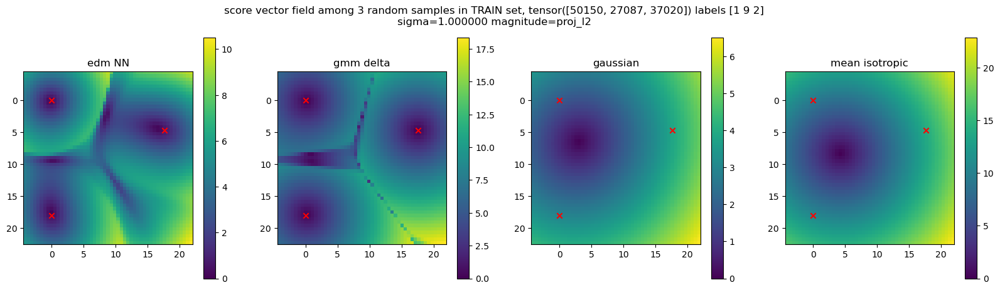

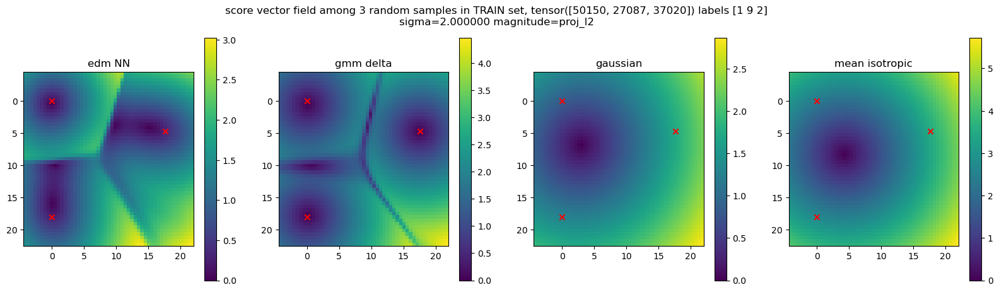

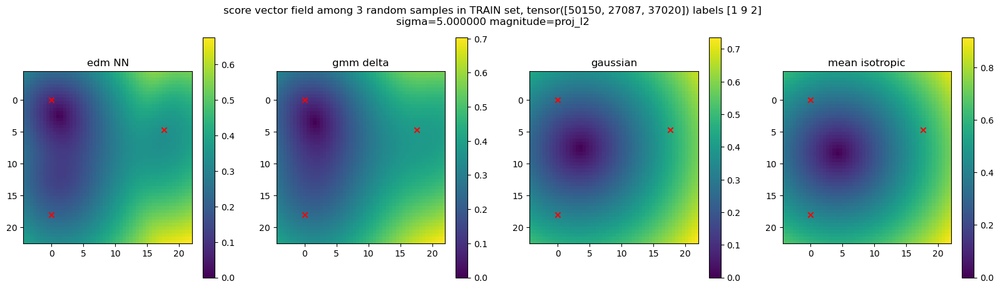

In [512]:
epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
knnidx = torch.randint(0, edm_Xmat.shape[0], (1, 3))
anchors = [edm_Xmat[knnidx[0,0], :], edm_Xmat[knnidx[0,1], :], edm_Xmat[knnidx[0,2], :]]
titlestr = f"among 3 random samples in TRAIN set, {knnidx[0].cpu()} labels {ytsr[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_slice_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, 
                       titlestr=titlestr,)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="ortho_l2",
                       titlestr=titlestr, grid_nums=(51, 51), show_image=False)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="proj_l2",
                       titlestr=titlestr, grid_nums=(51, 51), show_image=False)

#### Training set, nearest neighbors to one point

Score vector field among 3 nearest samples in TRAIN set, tensor([   10, 41428, 58483]) labels [3 3 3]


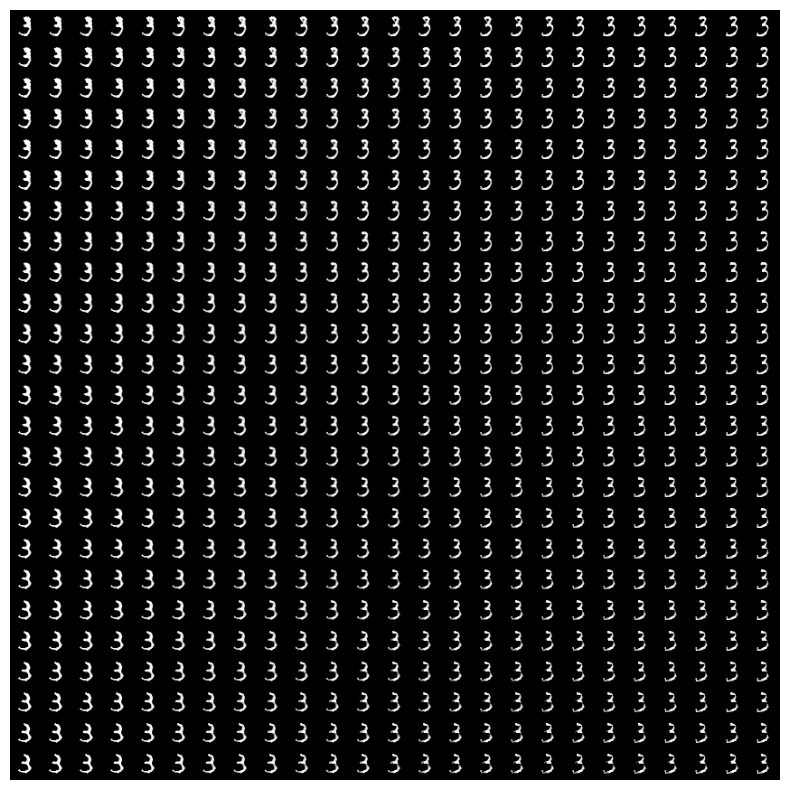

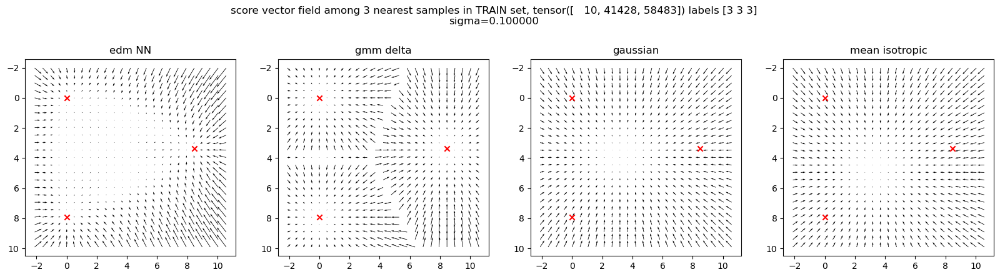

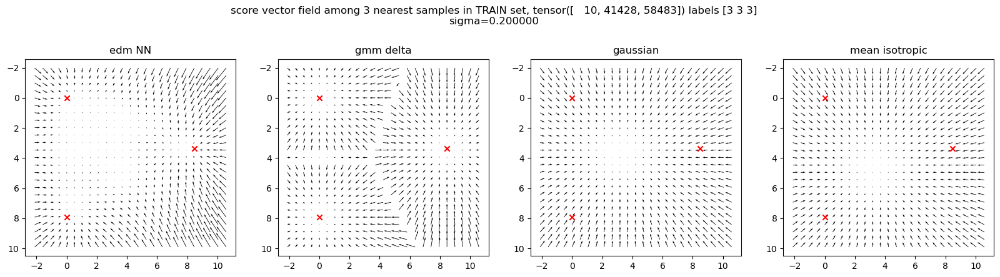

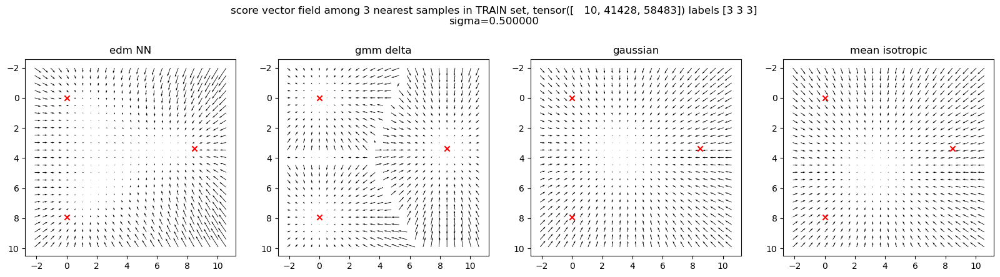

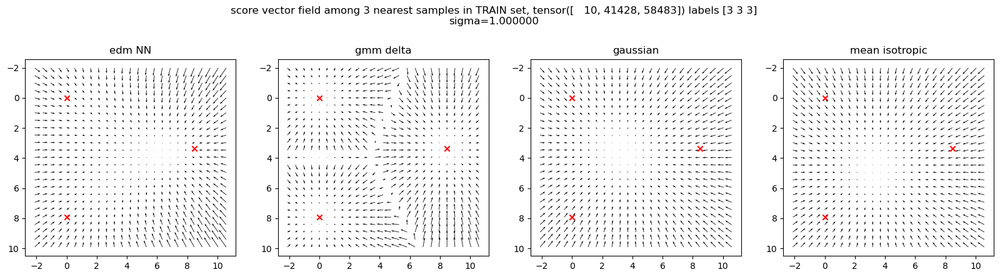

...

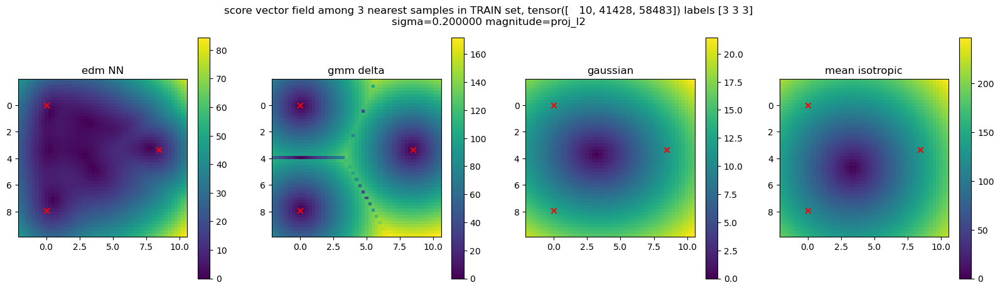

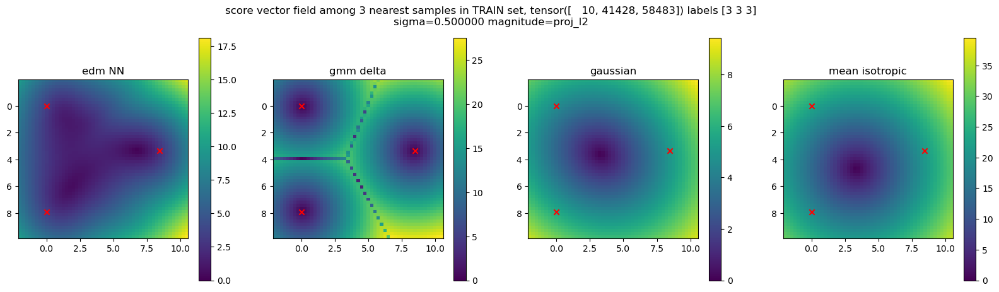

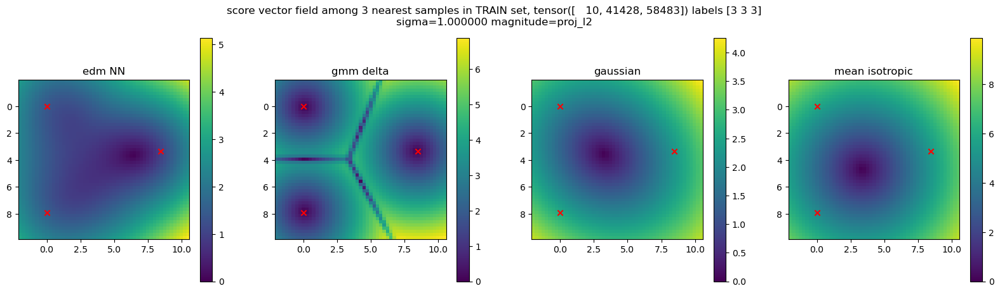

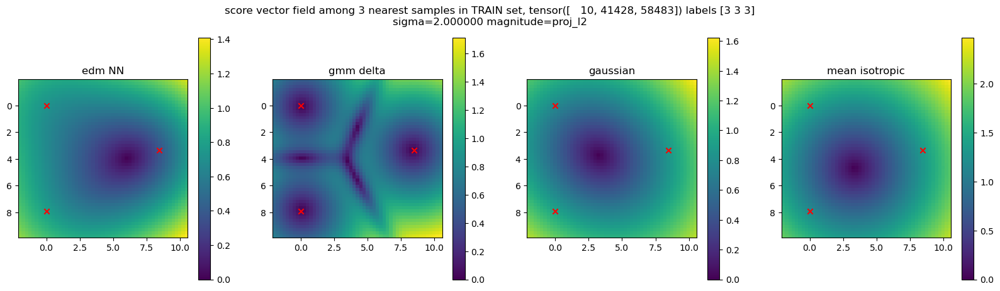

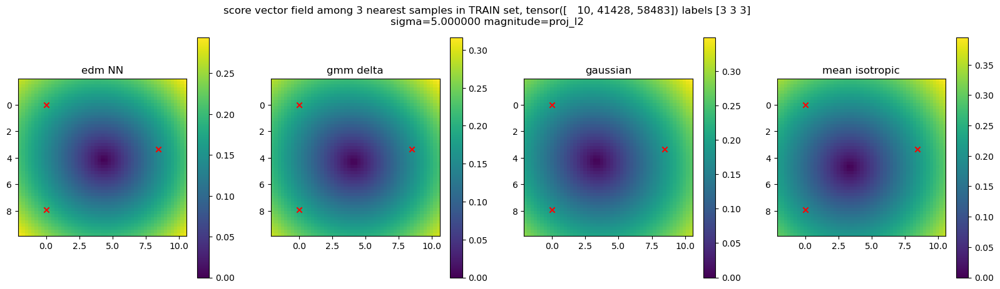

In [513]:

epoch = 300000
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
dist2anchor = torch.cdist(edm_Xmat[10:11, :], edm_Xmat)
knndist, knnidx = torch.topk(dist2anchor, k=3, dim=-1, largest=False)
anchors = [edm_Xmat[knnidx[0,0], :], edm_Xmat[knnidx[0,1], :], edm_Xmat[knnidx[0,2], :]]
titlestr = f"among 3 nearest samples in TRAIN set, {knnidx[0].cpu()} labels {ytsr[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_slice_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, 
                       titlestr=titlestr,)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="ortho_l2",
                       titlestr=titlestr, grid_nums=(51, 51), show_image=False)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="proj_l2",
                       titlestr=titlestr, grid_nums=(51, 51), show_image=False)

#### Test set, nearest neighbors to one point

Score vector field among 3 nearest samples in TEST set, tensor([  12, 6411, 5671]) labels [9 9 9]


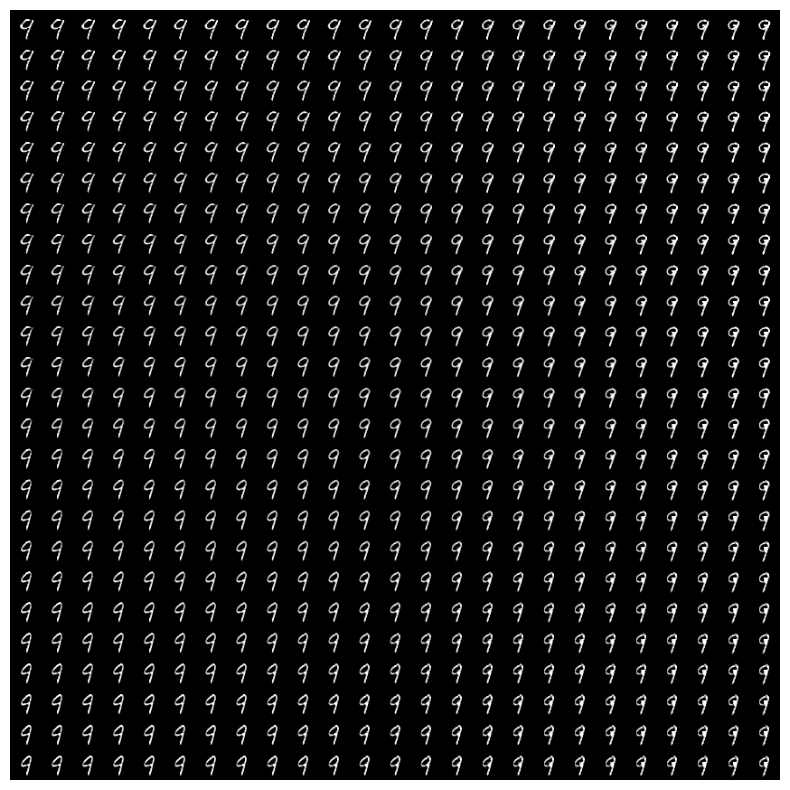

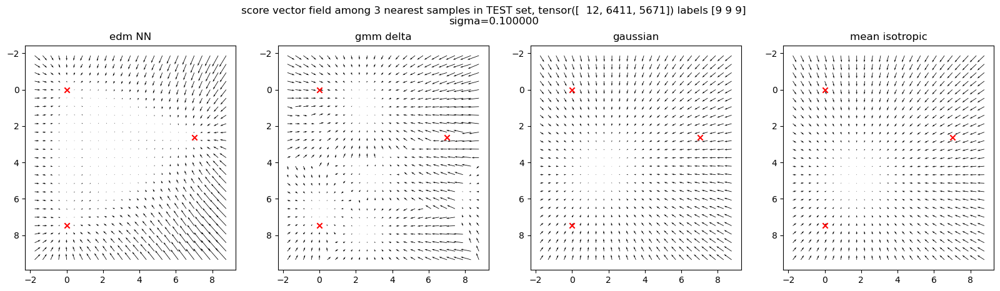

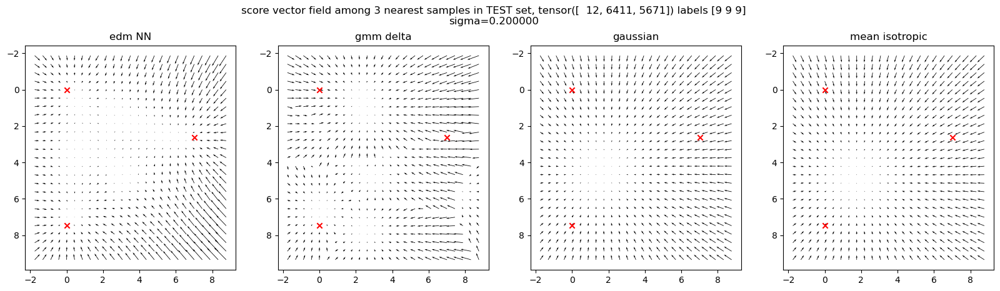

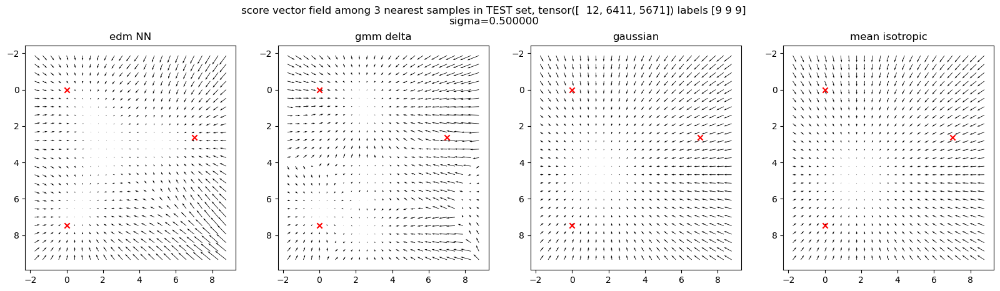

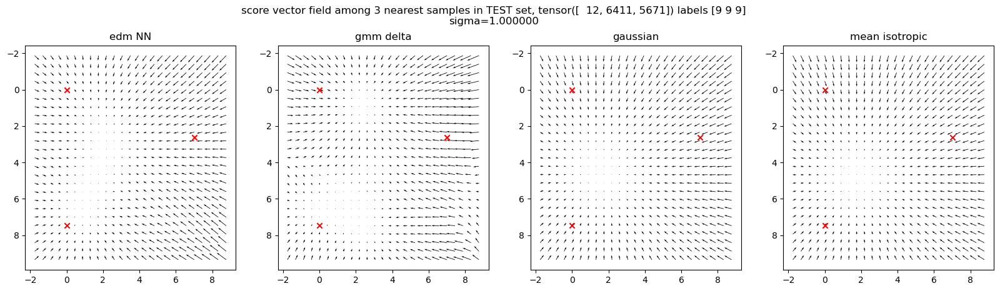

...

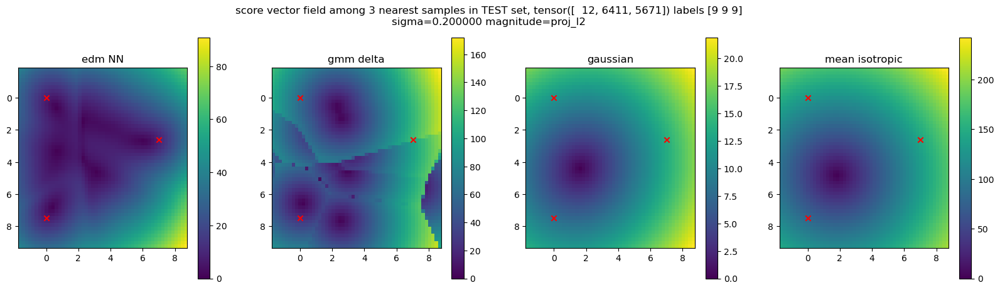

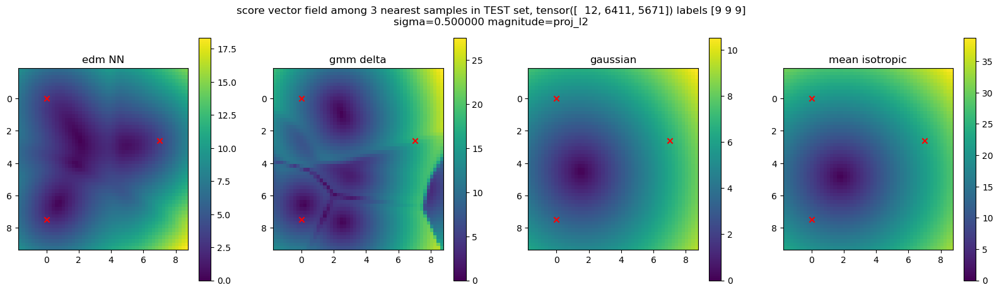

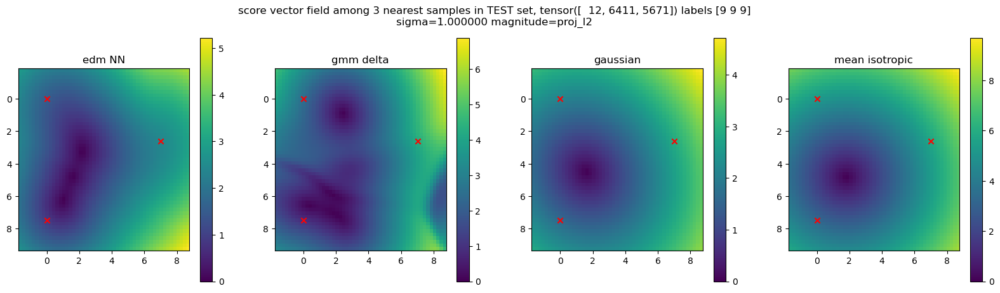

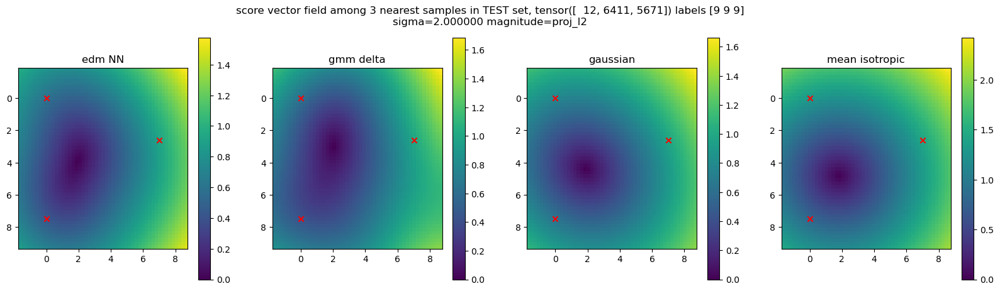

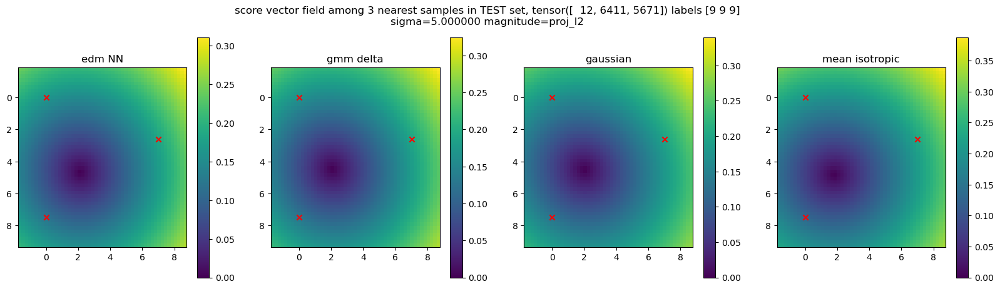

In [516]:
epoch = 300000
edm_Xmat_test = edm_Xmat_test.to(device)
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
dist2anchor = torch.cdist(edm_Xmat_test[12:13, :], edm_Xmat_test)
knndist, knnidx = torch.topk(dist2anchor, k=3, dim=-1, largest=False)
anchors = [edm_Xmat_test[knnidx[0,0], :], edm_Xmat_test[knnidx[0,1], :], edm_Xmat_test[knnidx[0,2], :]]
titlestr = f"among 3 nearest samples in TEST set, {knnidx[0].cpu()} labels {ytsr_test[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_slice_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, 
                       titlestr=titlestr,)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="ortho_l2",
                       titlestr=titlestr, grid_nums=(51, 51), show_image=False)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="proj_l2",
                       titlestr=titlestr, grid_nums=(51, 51), show_image=False)

#### Test set: random point samples

Score vector field among 3 random samples in TEST set, tensor([8847, 8929, 9063]) labels [5 0 3]


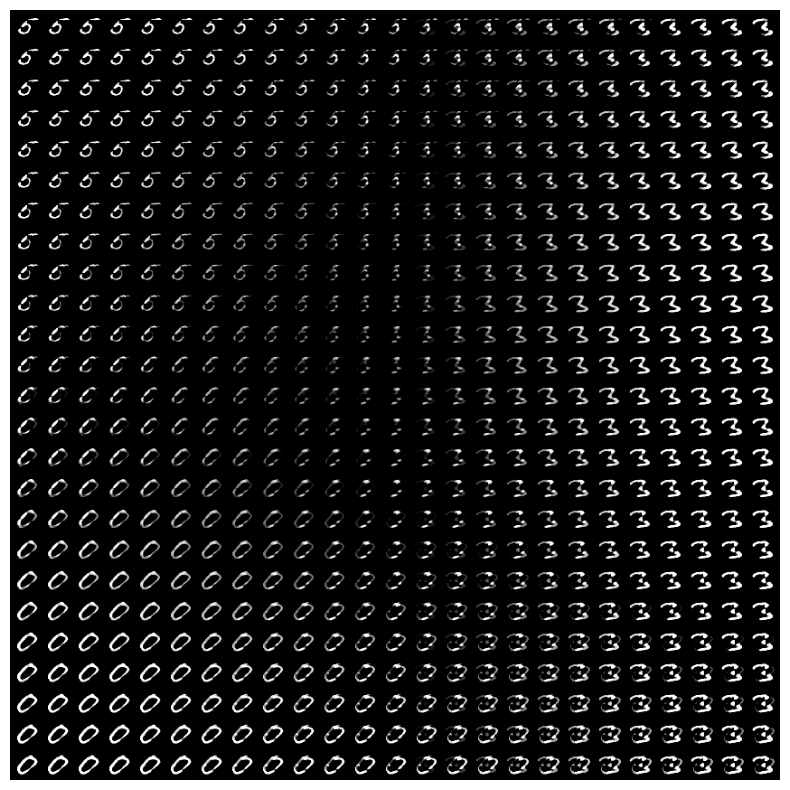

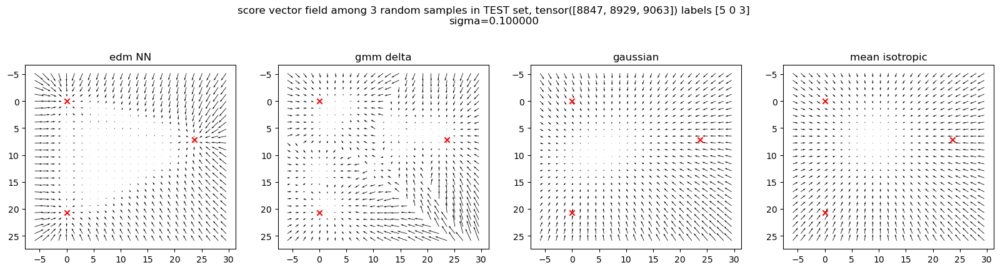

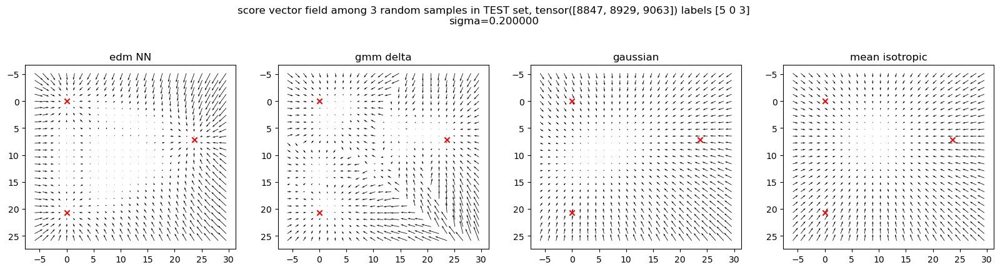

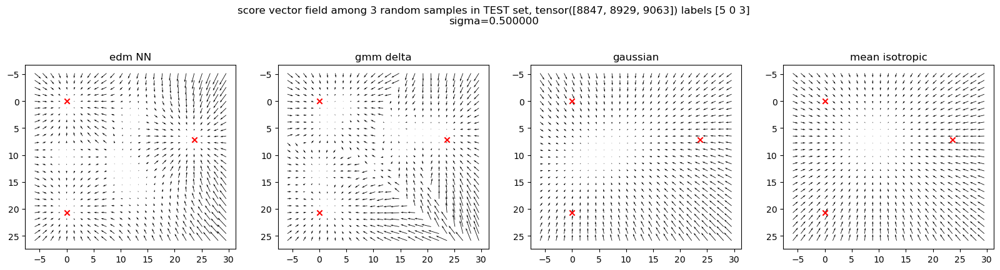

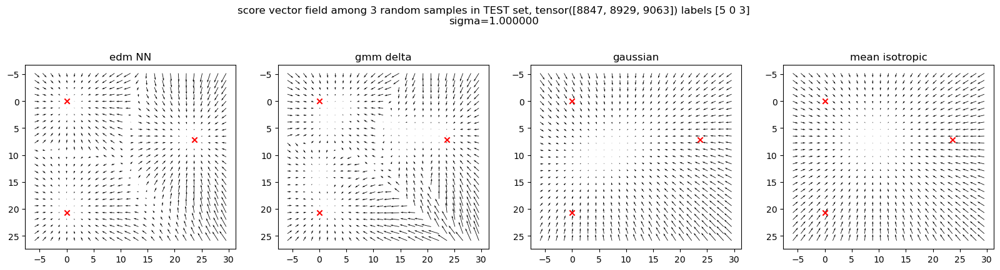

...

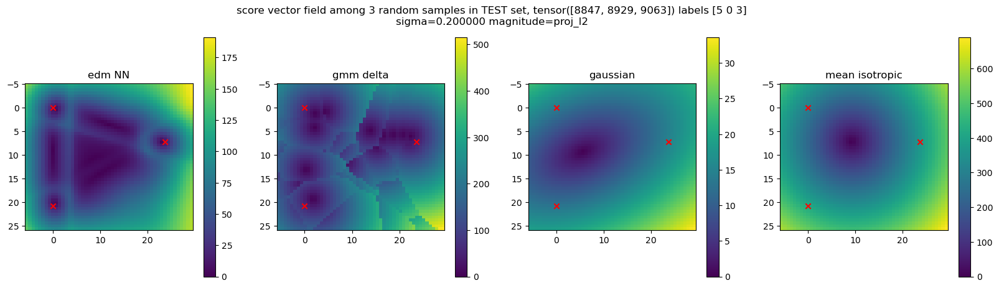

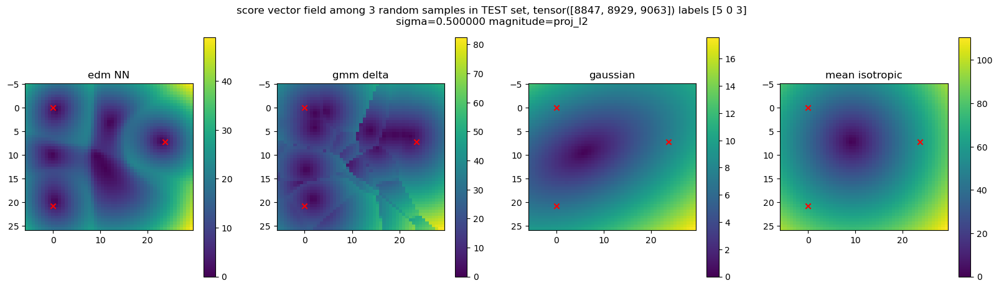

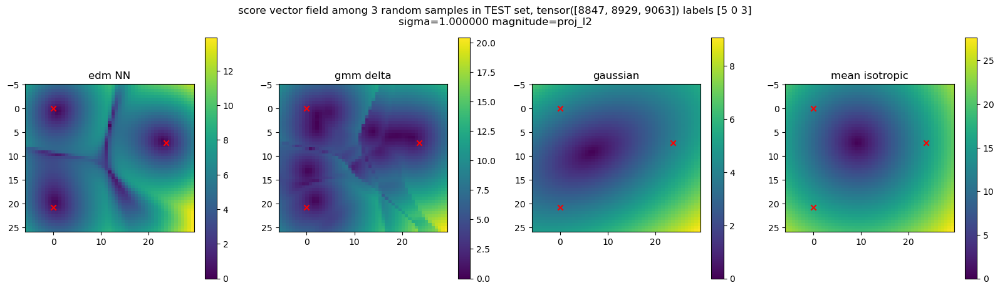

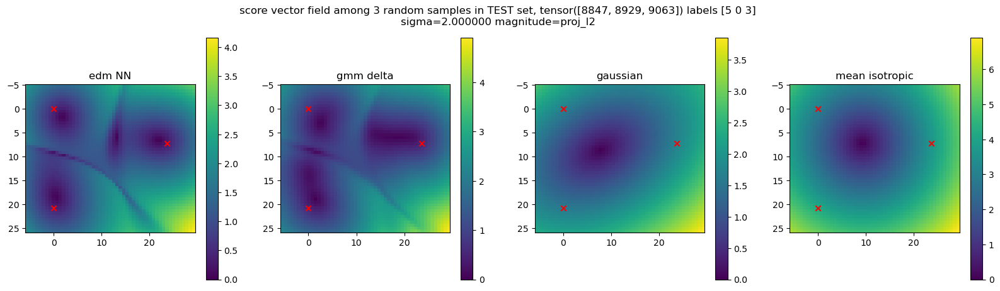

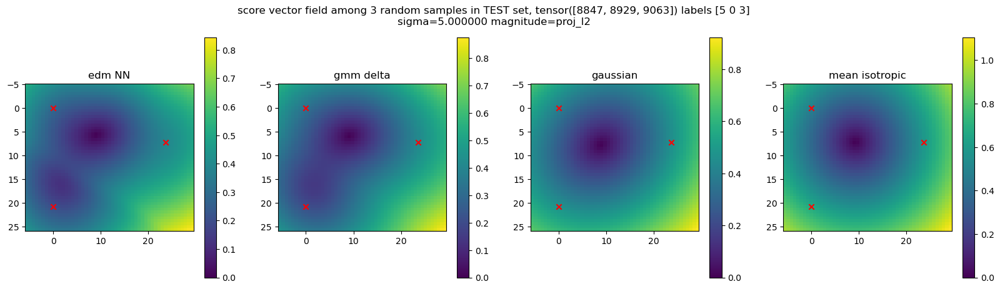

In [515]:
epoch = 300000
edm_Xmat_test = edm_Xmat_test.to(device)
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
# dist2anchor = torch.cdist(edm_Xmat_test[10:11, :], edm_Xmat_test)
# knndist, knnidx = torch.topk(dist2anchor, k=3, dim=-1, largest=False)
# knnidx = torch.randint(edm_Xmat_test.shape[0], (1, 3))
knnidx = torch.tensor([[8847, 8929, 9063]])
anchors = [edm_Xmat_test[knnidx[0,0], :], edm_Xmat_test[knnidx[0,1], :], edm_Xmat_test[knnidx[0,2], :]]
titlestr = f"among 3 random samples in TEST set, {knnidx[0].cpu()} labels {ytsr_test[knnidx[0].cpu()].numpy()}"
print("Score vector field", titlestr)
score_slice_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, 
                       titlestr=titlestr,)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="ortho_l2",
                       titlestr=titlestr, grid_nums=(51, 51), show_image=False)
score_magnitude_projection(anchors, edm, edm_Xmean, edm_Xcov, edm_imgshape, magnitude="proj_l2",
                       titlestr=titlestr, grid_nums=(51, 51), show_image=False)

### Combined Vector field comparison

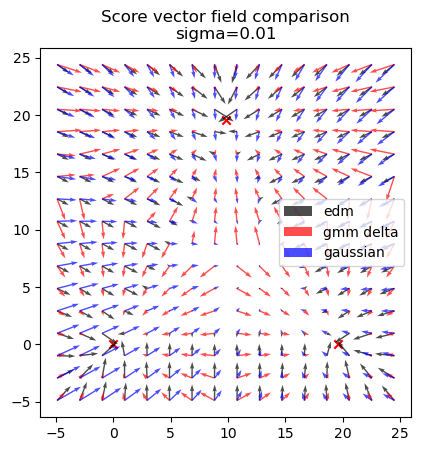

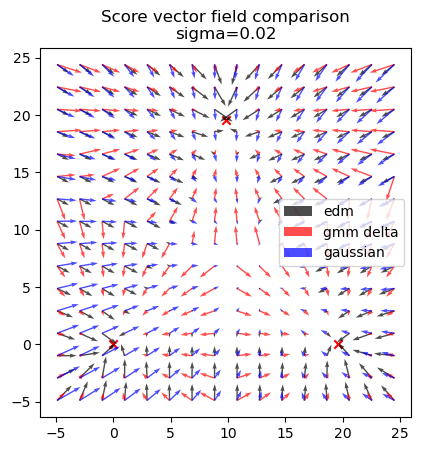

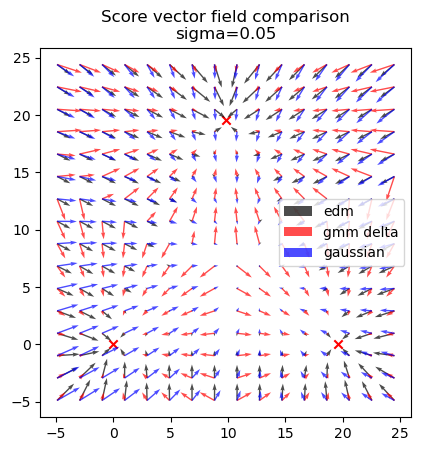

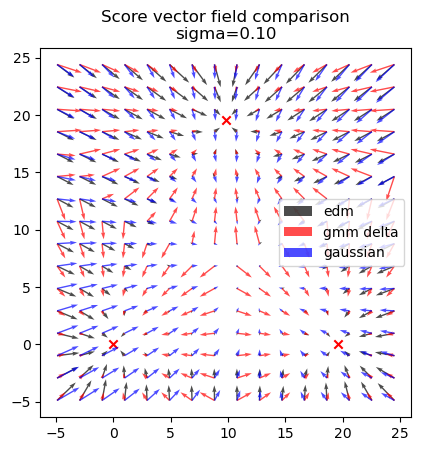

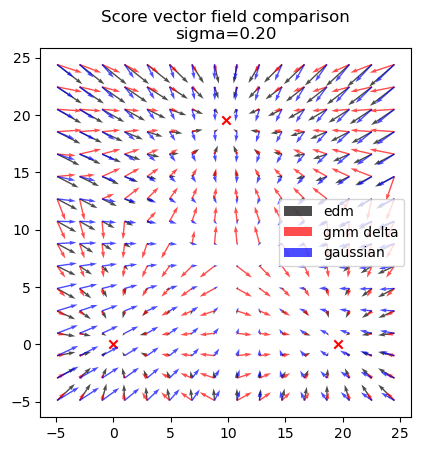

...

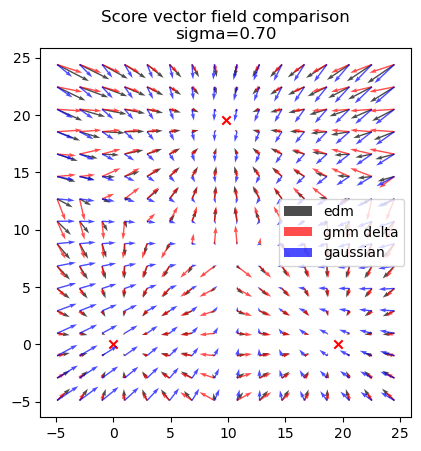

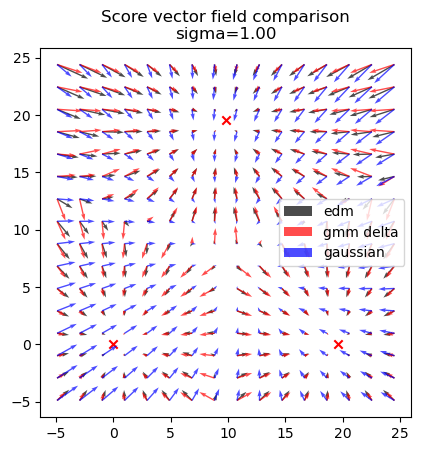

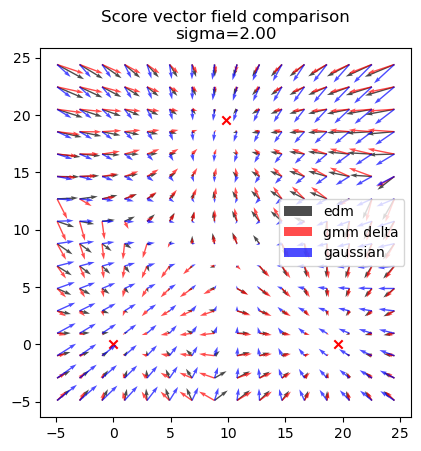

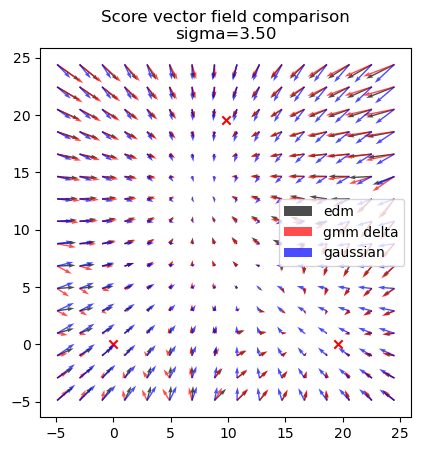

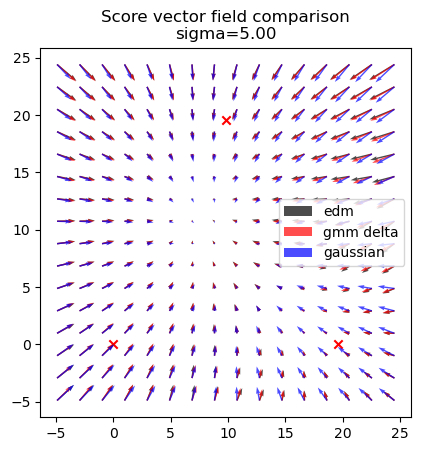

In [332]:
import matplotlib.pyplot as plt
anchors = [edm_Xmat[0, :], edm_Xmat[1, :], edm_Xmat[4, :]]
grid_vecs, norm_coords, plane_coords, coordsys = orthogonal_grid_torch(
        *anchors, grid_nums=(16, 16), x_range=(-0.25, 1.25), y_range=(-0.25, 1.25))
anchors_tsr = torch.stack(anchors)

# sigma = 1.0
for sigma in [0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 0.7, 1.0, 2.0, 3.5, 5.0]:
    edm_Dt = edm(grid_vecs.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(grid_vecs.shape) - grid_vecs) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(grid_vecs, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(grid_vecs, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    # score_gaussian1st_Xt = Gaussian_1stexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    # score_gaussian2nd_Xt = Gaussian_2ndexpens_score(grid_vecs, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(grid_vecs, edm_Xmat, sigma)
    # Calculate the vector field

    fig, ax = plt.subplots()
    ax.scatter(coordsys.project_points(anchors_tsr).cpu()[:, 0],
            coordsys.project_points(anchors_tsr).cpu()[:, 1], color='r', marker='x')
    for name, vector_field, clr in [("edm", score_edm, "black"),
                        ("gmm delta", score_gmm_Xt, "red"),
                        ("gaussian", score_gaussian_Xt, "blue"), 
                        # ("gaussian regularize", score_gaussian_reg_Xt),
                        # ("mean isotropic", score_mean_Xt), 
                        # ("mean + std isotropic", score_mean_std_Xt), 
                        # ("gaussian 1st expansion", score_gaussian1st_Xt), 
                        # ("gaussian 2nd expansion", score_gaussian2nd_Xt), 
                        ]:
        vec_proj = coordsys.project_vector(vector_field).cpu().numpy()
        ax.quiver(plane_coords[:, 0], plane_coords[:, 1], vec_proj[:, 0], vec_proj[:, 1], 
                label=name, color=clr, alpha=0.7)
    ax.set_aspect('equal')
    ax.set_title(f"Score vector field comparison\nsigma={sigma:.2f}")
    plt.legend()
    plt.show()


In [ ]:
print(f"epoch={epoch}")
edm = load_create_edm(config, f"/n/home12/binxuwang/Github/mini_edm/exps/base_mnist_20240129-1342/checkpoints/ema_{epoch}.pth")
for sigma in [0.002, 0.005, 0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 0.75, 1.0, 1.5, 2.0, 5.0, 10.0]:
    # Xt = sample_Xt_batch(edm_Xmat, 5000, sigma=sigma)
    grid_Xs 
    Xt = ...
    edm_Dt = edm(Xt.view(-1, *edm_imgshape), torch.tensor(sigma), None, use_ema=False).detach()
    score_edm = (edm_Dt.view(Xt.shape) - Xt) / (sigma**2)
    score_mean_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma)
    score_mean_std_Xt = mean_isotropic_score(Xt, edm_Xmean, sigma, sigma0=edm_std_mean)
    score_gaussian_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian_reg_Xt = Gaussian_score(Xt, edm_Xmean, edm_Xcov + torch.eye(edm_Xcov.shape[0]).to(device) * 1E-4, sigma)
    score_gaussian1st_Xt = Gaussian_1stexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gaussian2nd_Xt = Gaussian_2ndexpens_score(Xt, edm_Xmean, edm_Xcov, sigma)
    score_gmm_Xt = delta_GMM_score(Xt, edm_Xmat, sigma)

In [ ]:
import numpy as np
from scipy.spatial import Delaunay

def simplex_grid(points, n):
    tri = Delaunay(points)
    simplex = tri.simplices
    barycentric = np.random.rand(n, 3)
    barycentric = barycentric / np.sum(barycentric, axis=1)[:, np.newaxis]
    grid_points = np.einsum('ijk,ik->ij', points[simplex], barycentric)
    return grid_points

# Assuming edm_Xmat is a numpy array of shape (3, n)
grid_points = simplex_grid(edm_Xmat, n=100)
print(grid_points)
